# Project Name: Pharma Sales Forecasting
- Project overview: The project is all about creating an end-to-end Forecasting machine learning model for sales of product(e.g.Drug) sold in pharmaceutical sector. Load sales data Stored in MySQL into python environment and use it for building Forecasting models for each drug. Then Deploy this models into production using Flask web development application.
- Objectives: 1. Understand MySQL Database system, store and Retrieve sales data from MySQL to python Environment. 2. to validate different methods and approaches related to sales time series data preparation, analysis and                         forecasting. 3. Selecting best Forecasting model (from Arima, Facebook's Prophet, ML, etc.) using Auto ML and deploy these best models into production.

- import neccessary python Packages into Environment.


In [1]:
import os
import mysql.connector  # For MySql connection
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import create_report # For Auto EDA.
from statsmodels.tsa.seasonal import seasonal_decompose # tsa = Time series analysis
from sklearn.pipeline import Pipeline
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Change directory to "DS project" in E drive.
os.chdir(r"D:\360digitmg\DS Projects\project codes")

In [3]:
# Make connection object (using XAMPP) for MySQL database.
connection=mysql.connector.connect(host='localhost',
                                   user='root',
                                   password='', 
                                   database='db1', 
                                   port="3306")

In [4]:
connection  # Exp o/p:  <mysql.connector.connection.MySQLConnection at 0x20693bb1970>

In [5]:
# List Tables stored in 'db1' database. 
data_tables=pd.read_sql_query('show tables from db1', connection)
data_tables

,Tables_in_db1
0,import_csv_to_sql_server
1,import_csv_to_sql_server_1
2,salesdaily
3,user_data


In [6]:
# saving table name column to variable
tables = data_tables['Tables_in_db1'] # getting table names

In [7]:
# print data in all tables
for table_name in tables:
    output=pd.read_sql_query(f'Describe {table_name}', connection)
    print(table_name)
    print(output, '\n')

import_csv_to_sql_server
   Field         Type Null Key Default Extra
0  COL 1   varchar(5)  YES        None      
1  COL 2  varchar(10)  YES        None      
2  COL 3   varchar(9)  YES        None      
3  COL 4   varchar(6)  YES        None      
4  COL 5   varchar(3)  YES        None      
5  COL 6   varchar(6)  YES        None       

import_csv_to_sql_server_1
        Field        Type Null Key Default Extra
0       EmpID      int(1)  YES        None      
1  First_Name  varchar(1)  YES        None      
2   Last_Name  varchar(1)  YES        None      
3      Gender  varchar(1)  YES        None      
4         Age      int(2)  YES        None      
5      Salary      int(6)  YES        None       

salesdaily
           Field           Type Null Key Default Extra
0          datum    varchar(10)  YES        None      
1          M01AB  decimal(11,9)  YES        None      
2          M01AE  decimal(10,9)  YES        None      
3          N02BA  decimal(11,9)  YES        None      


# Loading data from MySQL Database to Jupyter.

In [8]:
# salesdaily = pd.read_sql_query('select * from salesdaily', connection, index_col= 'datum')  #, parse_date=True) 
# it make datum col as index col but parse date will not work, it will take datum col as object & make it index col.

In [9]:
# save salesdaily table data to datafram.
salesdaily = pd.read_sql_query('select * from salesdaily', connection) 
salesdaily.head()    
# we have loaded salesdaily data table from mysql.

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06,Year,Month,Hour,Weekday Name
0,1/2/2014,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0,2014,1,248,Thursday
1,1/3/2014,8.0,4.00,4.4,50.60,16.0,0.0,20.0,4.0,2014,1,276,Friday
2,1/4/2014,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0,2014,1,276,Saturday
3,1/5/2014,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0,2014,1,276,Sunday
4,1/6/2014,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0,2014,1,276,Monday


In [10]:
salesdaily.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2106 entries, 0 to 2105
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   datum         2106 non-null   object 
 1   M01AB         2106 non-null   float64
 2   M01AE         2106 non-null   float64
 3   N02BA         2106 non-null   float64
 4   N02BE         2106 non-null   float64
 5   N05B          2106 non-null   float64
 6   N05C          2106 non-null   float64
 7   R03           2106 non-null   float64
 8   R06           2106 non-null   float64
 9   Year          2106 non-null   int64  
 10  Month         2106 non-null   int64  
 11  Hour          2106 non-null   int64  
 12  Weekday Name  2106 non-null   object 
dtypes: float64(8), int64(3), object(2)
memory usage: 214.0+ KB


In [11]:
salesdaily.datum= pd.to_datetime(salesdaily.datum)
salesdaily.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2106 entries, 0 to 2105
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   datum         2106 non-null   datetime64[ns]
 1   M01AB         2106 non-null   float64       
 2   M01AE         2106 non-null   float64       
 3   N02BA         2106 non-null   float64       
 4   N02BE         2106 non-null   float64       
 5   N05B          2106 non-null   float64       
 6   N05C          2106 non-null   float64       
 7   R03           2106 non-null   float64       
 8   R06           2106 non-null   float64       
 9   Year          2106 non-null   int64         
 10  Month         2106 non-null   int64         
 11  Hour          2106 non-null   int64         
 12  Weekday Name  2106 non-null   object        
dtypes: datetime64[ns](1), float64(8), int64(3), object(1)
memory usage: 214.0+ KB


In [12]:
salesdaily.set_index('datum', inplace=True)
salesdaily.head()

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06,Year,Month,Hour,Weekday Name
datum,,,,,,,,,,,,
2014-01-02,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0,2014,1,248,Thursday
2014-01-03,8.0,4.00,4.4,50.60,16.0,0.0,20.0,4.0,2014,1,276,Friday
2014-01-04,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0,2014,1,276,Saturday
2014-01-05,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0,2014,1,276,Sunday
2014-01-06,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0,2014,1,276,Monday


# Import data from local database
To avoid repeatedly import of data from MySQL while trail & error of running code 

In [2]:
# loading data from local systme too. To avoid use of use of Mysql here while Trying. 
salesdaily = pd.read_csv(r'D:\360digitmg\DS Projects\proj70_data\salesdaily.csv', index_col='datum', parse_dates = True)
# making copy of data, in case we need it.
salesdaily2 = salesdaily.copy()
salesdaily.head()

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06,Year,Month,Hour,Weekday Name
datum,,,,,,,,,,,,
2014-01-02,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0,2014,1,248,Thursday
2014-01-03,8.0,4.00,4.4,50.60,16.0,0.0,20.0,4.0,2014,1,276,Friday
2014-01-04,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0,2014,1,276,Saturday
2014-01-05,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0,2014,1,276,Sunday
2014-01-06,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0,2014,1,276,Monday


In [14]:
salesdaily.tail()

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06,Year,Month,Hour,Weekday Name
datum,,,,,,,,,,,,
2019-10-04,7.34,5.683,2.25,22.45,13.0,0.0,1.0,1.00,2019,10,276,Friday
2019-10-05,3.84,5.010,6.00,25.40,7.0,0.0,0.0,0.33,2019,10,276,Saturday
2019-10-06,4.00,11.690,2.00,34.60,6.0,0.0,5.0,4.20,2019,10,276,Sunday
2019-10-07,7.34,4.507,3.00,50.80,6.0,0.0,10.0,1.00,2019,10,276,Monday
2019-10-08,0.33,1.730,0.50,44.30,20.0,2.0,2.0,0.00,2019,10,190,Tuesday


# Data Understanding

The dataset is built from the initial dataset consisted of 600000 transactional data collected in 6 years (period 2014-2019),
 indicating date and time of sale, pharmaceutical drug brand name and sold quantity, exported from Point-of-Sale system in the individual pharmacy.
 Selected group of drugs from the dataset (57 drugs) is classified to the following Anatomical Therapeutic Chemical (ATC) Classification System categories:

- M01AB - Anti-inflammatory and antirheumatic products, non-steroids, Acetic acid derivatives and related substances
- M01AE - Anti-inflammatory and antirheumatic products, non-steroids, Propionic acid derivatives
- N02BA - Other analgesics and antipyretics, Salicylic acid and derivatives
- N02BE/B - Other analgesics and antipyretics, Pyrazolones and Anilides
- N05B - Psycholeptics drugs, Anxiolytic drugs
- N05C - Psycholeptics drugs, Hypnotics and sedatives drugs
- R03 - Drugs for obstructive airway diseases
- R06 - Antihistamines for systemic use

Sales data are resampled to the hourly, daily, weekly and monthly periods.we are considering daily sales for Forecasting.


In [15]:
# Now we can start preprocessing of data.
salesdaily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2106 entries, 2014-01-02 to 2019-10-08
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   M01AB         2106 non-null   float64
 1   M01AE         2106 non-null   float64
 2   N02BA         2106 non-null   float64
 3   N02BE         2106 non-null   float64
 4   N05B          2106 non-null   float64
 5   N05C          2106 non-null   float64
 6   R03           2106 non-null   float64
 7   R06           2106 non-null   float64
 8   Year          2106 non-null   int64  
 9   Month         2106 non-null   int64  
 10  Hour          2106 non-null   int64  
 11  Weekday Name  2106 non-null   object 
dtypes: float64(8), int64(3), object(1)
memory usage: 213.9+ KB


# EDA and Auto EDA

In [16]:
# change schema of datum column to datetime
#salesdaily.datum= pd.to_datetime(salesdaily.datum)
#salesdaily.info()

### Auto EDA using DataPrep library.
- In Auto-EDA we get to know about the missing values, duplicates rows, outliers (Box plot in details), bar chart for skewness of data, Q-Q plot for Normal Destribution, etc.
- we also all four business Moments of Business Decisions in stat's Descriptive Statistics in details of each column.
- There are many Auto-EDA libraries other than DataPrep, these libraries are Pandas Profiling, Sweetviz, Autoviz, and D-Tale.


  0%|                                                                                         | 0/2061 [00:00<…

DataPrep Report
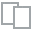
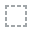
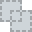
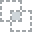
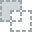
...
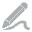
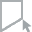
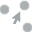
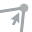
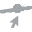

In [3]:
# Automatic EDA.
create_report(salesdaily)

From above auto EDA part, it can be seen that there are:
- No missing values, 
- No duplicates, 
- All drug columns are right skewed, 
- Outliers exists for drug columns. 

whicker sizes are (Q1-1.5*IQR) and (Q3+1.5*IQR).


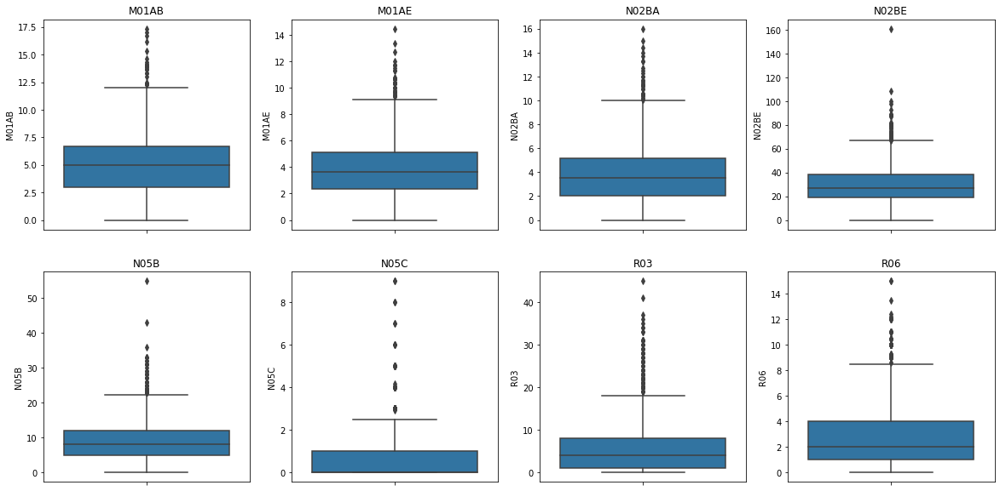

In [18]:
plt.figure(figsize=(20,10)) # Entire size of the graph.

plt.subplot(2, 4, 1)
sns.boxplot(y=salesdaily.M01AB);plt.title('M01AB')

plt.subplot(2, 4, 2)
sns.boxplot(y=salesdaily.M01AE);plt.title('M01AE')

plt.subplot(2, 4, 3)
sns.boxplot(y=salesdaily.N02BA);plt.title('N02BA')

plt.subplot(2, 4, 4)
sns.boxplot(y=salesdaily.N02BE);plt.title('N02BE')

plt.subplot(2, 4, 5)
sns.boxplot(y=salesdaily.N05B);plt.title('N05B')

plt.subplot(2, 4, 6)
sns.boxplot(y=salesdaily.N05C);plt.title('N05C')

plt.subplot(2, 4, 7)
sns.boxplot(y=salesdaily.R03);plt.title('R03')

plt.subplot(2, 4, 8)
sns.boxplot(y=salesdaily.R06);plt.title('R06')

plt.show()

Number of outliers in  each columns

In [19]:
drug_list = ['M01AB', 'M01AE', 'N02BA', 'N02BE', 'N05B', 'N05C', 'R03','R06']

for drug in drug_list:
    IQR = salesdaily[drug].quantile(0.75) - salesdaily[drug].quantile(0.25)
    lower_limit = salesdaily[drug].quantile(0.25) - (IQR*1.5)
    if lower_limit < 0:
        lower_limit = 0.0
    upper_limit = salesdaily[drug].quantile(0.75) + (IQR*1.5)
    outliers_df = np.where(salesdaily[drug] > upper_limit, True, np.where(salesdaily[drug] < lower_limit, True, False))
    print(f'There are {outliers_df.sum()} outlier in {drug} column.', '\n')

There are 26 outlier in M01AB column. 

There are 40 outlier in M01AE column. 

There are 31 outlier in N02BA column. 

There are 48 outlier in N02BE column. 

There are 48 outlier in N05B column. 

There are 160 outlier in N05C column. 

There are 124 outlier in R03 column. 

There are 81 outlier in R06 column. 



#### Discriptive statistics
- The descriptive statistics for all drugs.

In [20]:
salesdaily.describe()

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06,Year,Month,Hour
count,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000,2106.000000
mean,5.033683,3.895830,3.880441,29.917095,8.853627,0.593522,5.512262,2.900198,2016.401235,6.344255,275.945869
std,2.737579,2.133337,2.384010,15.590966,5.605605,1.092988,6.428736,2.415816,1.665060,3.386954,1.970547
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2014.000000,1.000000,190.000000
25%,3.000000,2.340000,2.000000,19.000000,5.000000,0.000000,1.000000,1.000000,2015.000000,3.000000,276.000000
50%,4.990000,3.670000,3.500000,26.900000,8.000000,0.000000,4.000000,2.000000,2016.000000,6.000000,276.000000
75%,6.670000,5.138000,5.200000,38.300000,12.000000,1.000000,8.000000,4.000000,2018.000000,9.000000,276.000000
max,17.340000,14.463000,16.000000,161.000000,54.833333,9.000000,45.000000,15.000000,2019.000000,12.000000,276.000000


#### check Non-Numeric values in data.

In [21]:

for drug in drug_list:
    print(drug)
    print(salesdaily[drug].unique(), '\n')

M01AB
[ 0.          8.          2.          4.          5.          5.33
  7.          7.34        6.          1.          4.33        4.67
  4.34        3.02        1.33        3.          3.33        2.66
 10.          9.          6.34        3.34        5.34        6.68
  2.31        2.68        8.68        5.68        2.34        2.67
  7.02        1.34        1.67        3.68        8.34        5.67
  0.34        6.33        2.33        7.33        0.68        5.02
 11.34        4.01        4.68        1.68        6.775       3.67
 12.          5.36        6.99        2.02       10.5        10.34
  6.67        8.5         3.66        6.01       11.68        3.01
  9.68       11.         10.33        9.84        4.66        9.33
  9.32        9.66       14.          8.33        9.34        5.17
  3.83        7.17        8.83        5.5         7.35        4.84
  8.49        2.5         5.84        1.5        14.18       12.33
  8.67        3.5         8.99       10.84        8.18  

#### Replacing outliers

In [22]:
from feature_engine.outliers import Winsorizer

In [23]:
winsor = Winsorizer(capping_method='iqr', tail = 'both', fold=1.5, variables = ['M01AB', 'M01AE', 'N02BA', 'N02BE', 'N05B',
                                                                              'N05C', 'R03','R06'])
salesdaily = winsor.fit_transform(salesdaily)

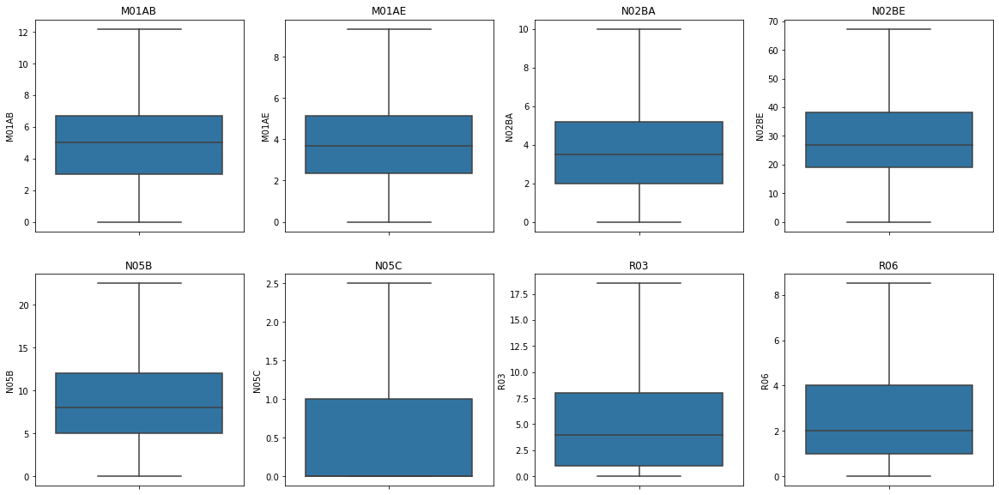

In [24]:
plt.figure(figsize=(20,10))

plt.subplot(2, 4, 1)
sns.boxplot(y=salesdaily.M01AB);plt.title('M01AB')

plt.subplot(2, 4, 2)
sns.boxplot(y=salesdaily.M01AE);plt.title('M01AE')

plt.subplot(2, 4, 3)
sns.boxplot(y=salesdaily.N02BA);plt.title('N02BA')

plt.subplot(2, 4, 4)
sns.boxplot(y=salesdaily.N02BE);plt.title('N02BE')

plt.subplot(2, 4, 5)
sns.boxplot(y=salesdaily.N05B);plt.title('N05B')

plt.subplot(2, 4, 6)
sns.boxplot(y=salesdaily.N05C);plt.title('N05C')

plt.subplot(2, 4, 7)
sns.boxplot(y=salesdaily.R03);plt.title('R03')

plt.subplot(2, 4, 8)
sns.boxplot(y=salesdaily.R06);plt.title('R06')

plt.show()

#### Univariate Analysis.

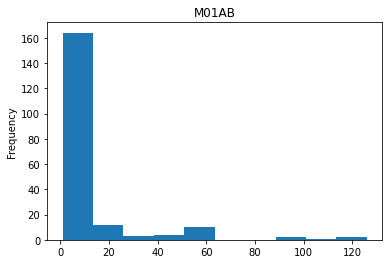

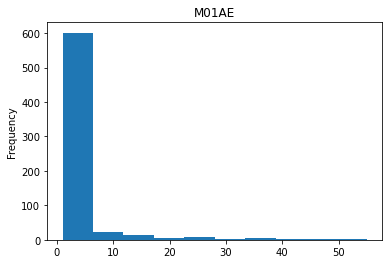

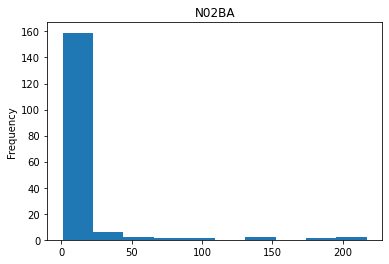

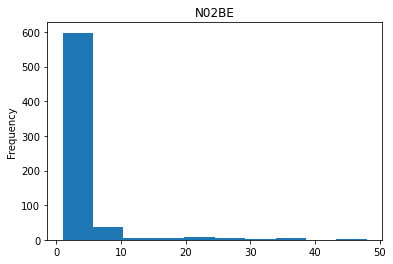

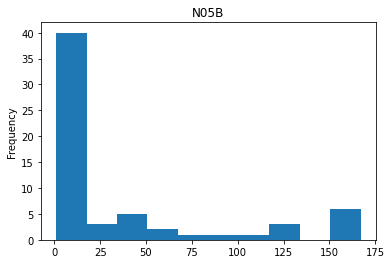

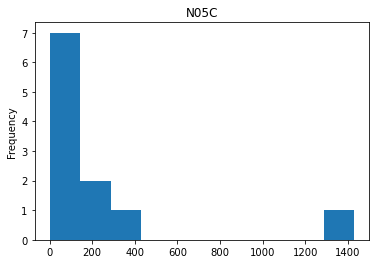

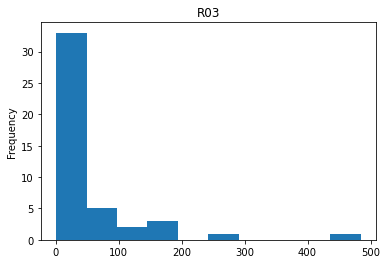

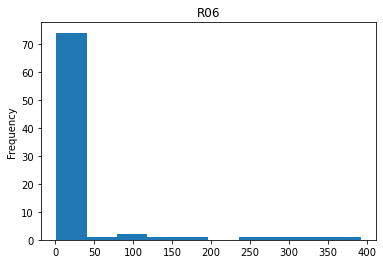

In [25]:
#checking  how many times each drug sold
for drug in drug_list:
    salesdaily[drug].value_counts().plot(kind='hist');plt.title(drug);plt.show()

#### Check number of times sales is zero for every drug

In [26]:
salesdaily.Year.value_counts()

2016    366
2015    365
2017    365
2018    365
2014    364
2019    281
Name: Year, dtype: int64

In [27]:
for drug in drug_list:
    print(f'{salesdaily[(salesdaily[drug]==0)].shape[0]} times the sale of {drug} is 0.', '\n')
    

40 times the sale of M01AB is 0. 

36 times the sale of M01AE is 0. 

78 times the sale of N02BA is 0. 

26 times the sale of N02BE is 0. 

43 times the sale of N05B is 0. 

1430 times the sale of N05C is 0. 

484 times the sale of R03 is 0. 

256 times the sale of R06 is 0. 



- we are getting how many times sales of drugs is zero in all 6 years (2014-2019). Among all drug, "N05C" has "No sale"  for 1430 days which is highest number of no sales days among all drugs. 
- Drug "N02BE" has least "No sale" days.

#### Correlation Analysis 
- To check Multi-collinearity problem.

<AxesSubplot:>

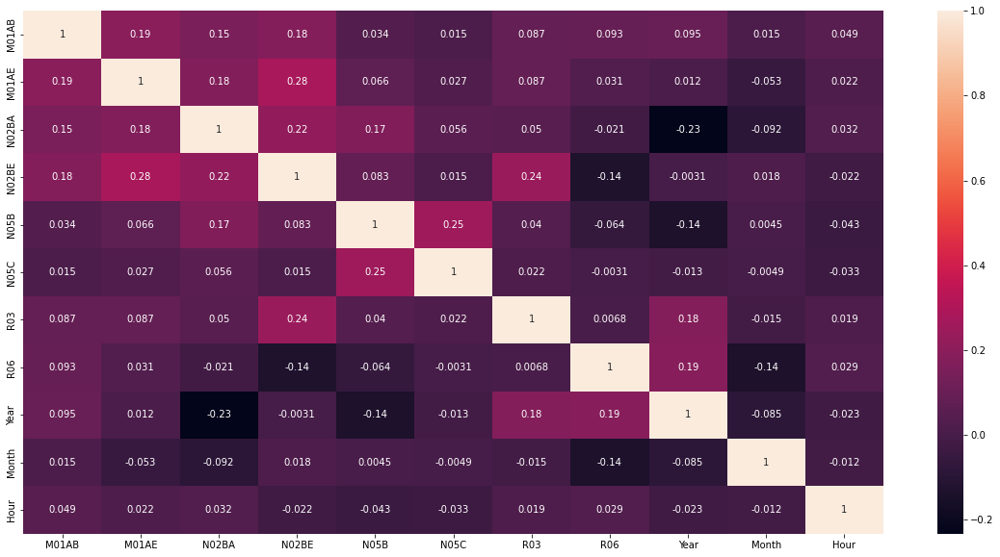

In [28]:
plt.figure(figsize=(20,10))
sns.heatmap(salesdaily.corr(),annot=True)

- From the above heat map, we can say that no any strong relation either positive or negative seen. 
- Hence, sales of each drug is independent of other drugs.

### Month wise sales pattern of each drug 
Getting monthly sales of the each drugs for all years 

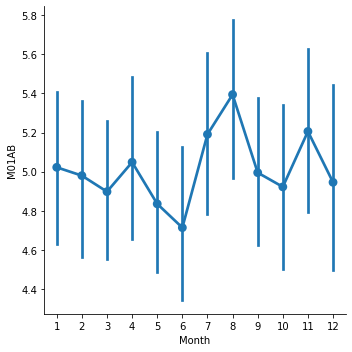

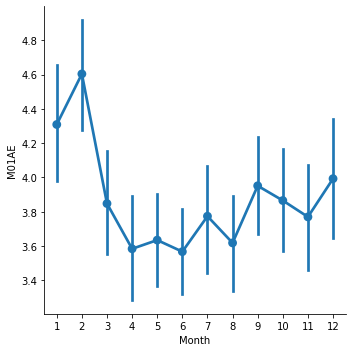

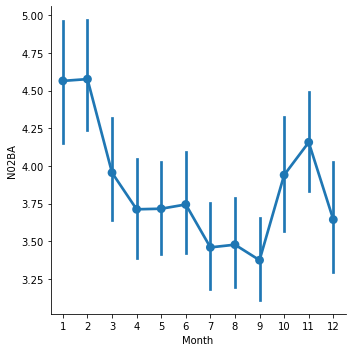

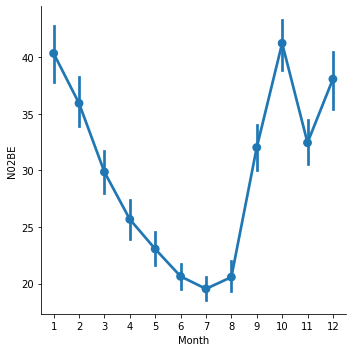

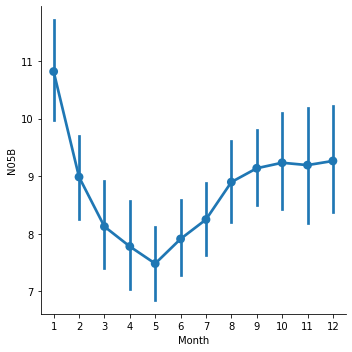

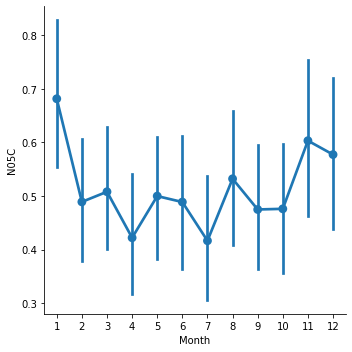

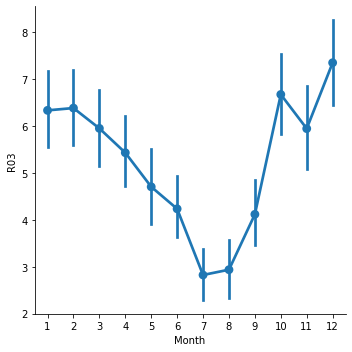

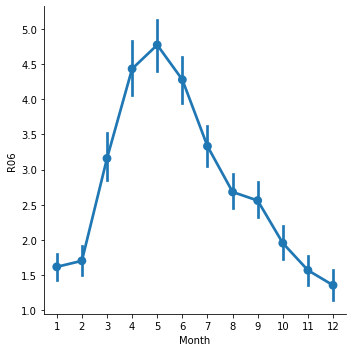

In [29]:
#We can see a strong negative correlation between the drugs ,hour,month ,year.
#now let us check month wise sale 
for drug in drug_list:
    sns.factorplot(data = salesdaily, x ="Month", y = drug )# , row = "Year")
      


- For drug "M01AB" & "N05C": cycle of sale goes up and down, sale of drug M01AB suddenly goes low in "Jun" then goes up in other half of year.
- For drugs "M01AE" and "N02BA": sale of these two drug is high for first two month then suddenly going down, then sale is moving along with same average of 3.75 for both durgs for rest of the year.
- For "N02BE", "N05B" & "R03": sale of these drug for first of the year is high then it gradually decreasing upto mid of the year then again goes up to initial salea numbers.
- For "R06": Sale of drug starts increasing after second month, it achieve peak in mid of the year then start decreasing.


### Week wise sales pattern of each drug 
Getting weekly sales of the each drugs for all years

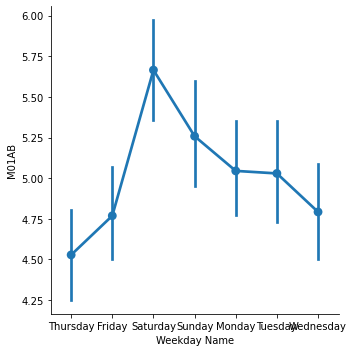

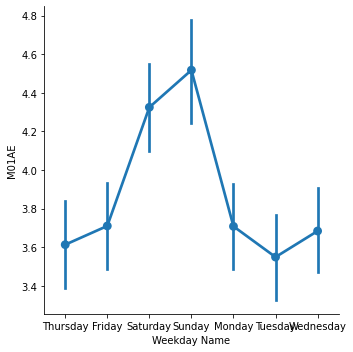

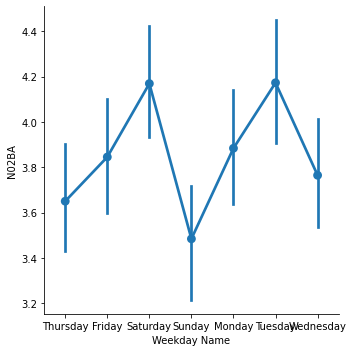

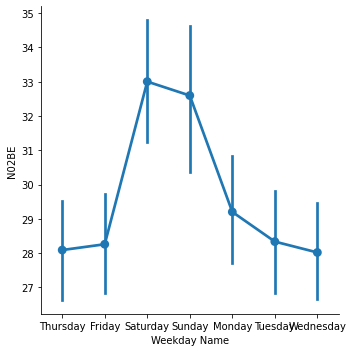

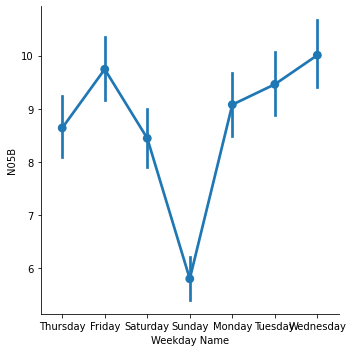

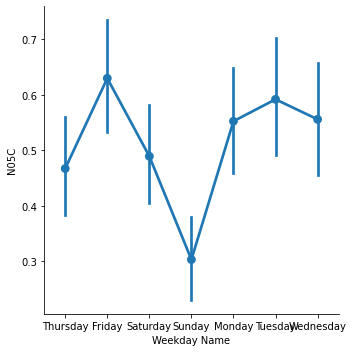

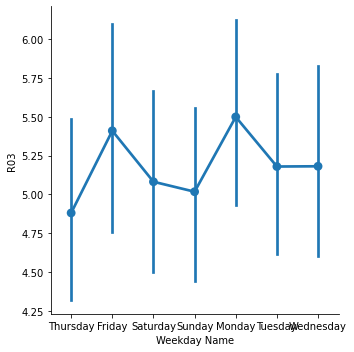

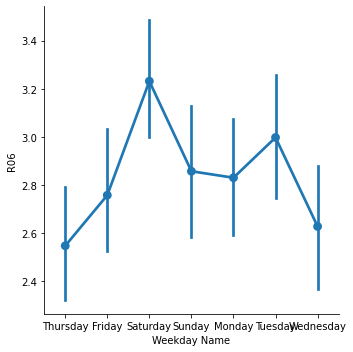

In [30]:

for drug in drug_list:
    sns.factorplot(data = salesdaily, x ="Weekday Name", y = drug )# , row = "Month")
     

- For drugs "M01AB", "M01AE", "N02BE"& "R06": for these drugs, sale is high for saturday and sunday.
- For drugs "N02BA", "N05B","N05C" : sale of the drug is less at saturday and sunday.
- For drug "R03": sale is cyclic. it is neither going up nor going much down. 

To Know the fuction of register_matplotlib_converters, see following links. 

https://stackoverflow.com/questions/61443261/what-is-the-use-of-pd-plotting-register-matplotlib-converters-in-pandas
https://github.com/facebook/prophet/issues/999

- These converters just make sure that for example datetime.datetime gets overwritten by pandas.
- Timestamp, allowing for compatibility with pandas. 
- Maybe this will help: it seems that there is another method called deregister_matplotlib_converters
- Data Preparation: input should be float type

In [31]:
# pd.plotting.register_matplotlib_converters()
   
# salesdaily.dtypes

### Line plot
- Making a line graph for visualization of the data. Line plot will tell about: 
1. level (i.e. Average), 
2.trend (upward trend, downward trend or constant trend over a period of time) and 
3.seasonality (Additive seasonality or Multiplicative seasonality) in the data.

https://analyticsindiamag.com/complete-guide-to-sarimax-in-python-for-time-series-modeling/
 - Read the article for more information about model building.

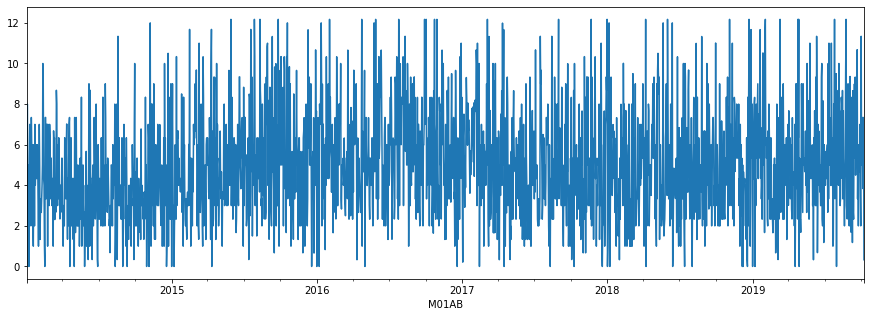

In [32]:
plt.figure(figsize=(15,5))
salesdaily.M01AB.plot(); plt.xlabel('M01AB'); plt.show()

# salesdaily.M01AB.plot(); plt.xlabel('M01AB'); plt.show()

# salesdaily.M01AE.plot(); plt.xlabel('M01AE'); plt.show()

# salesdaily.N02BA.plot(); plt.xlabel('N02BA'); plt.show()

# salesdaily.N02BE.plot(); plt.xlabel('N02BE'); plt.show()

# salesdaily.N05B.plot(); plt.xlabel('N05B'); plt.show()

# salesdaily.N05C.plot(); plt.xlabel('N05C'); plt.show()

# salesdaily.R03.plot(); plt.xlabel('R03'); plt.show()

# salesdaily.R06.plot(); plt.xlabel('R06'); plt.show()

 Getting line plot on weekly basis for all drugs

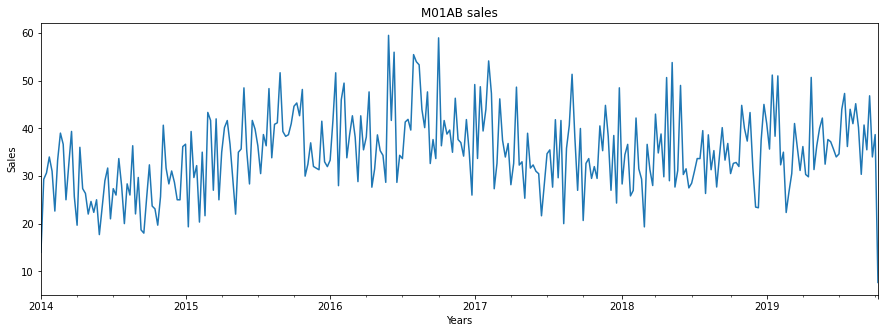

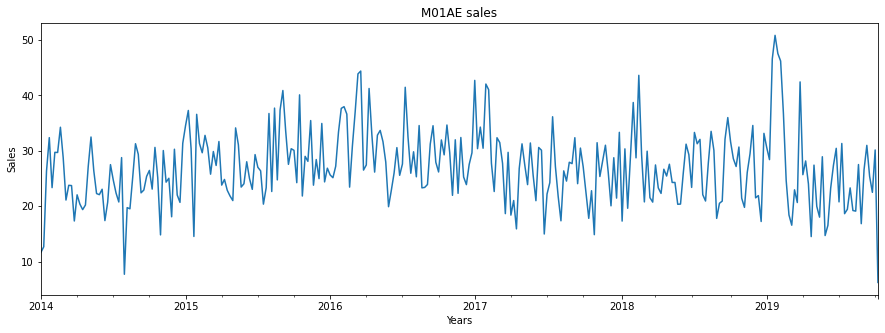

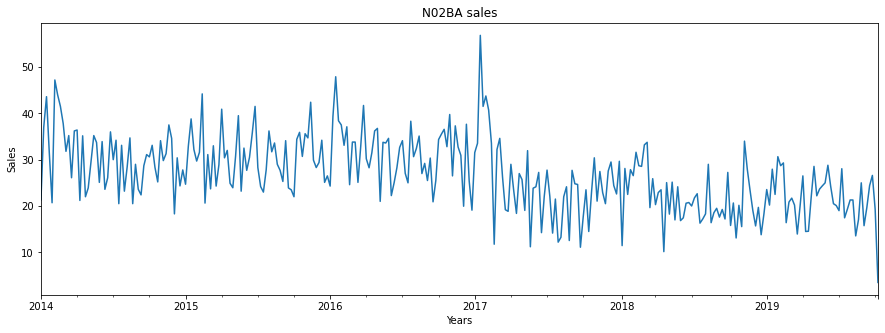

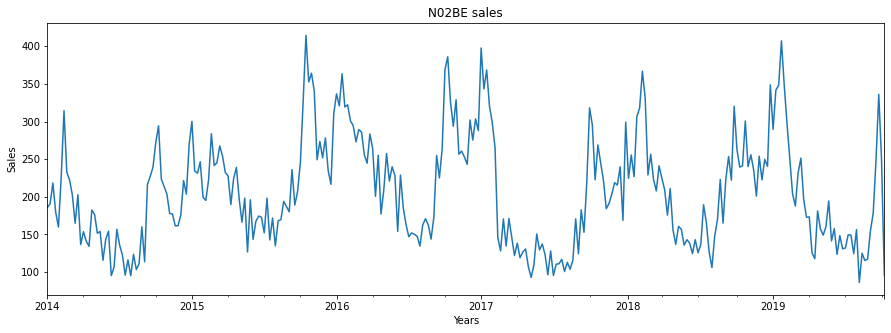

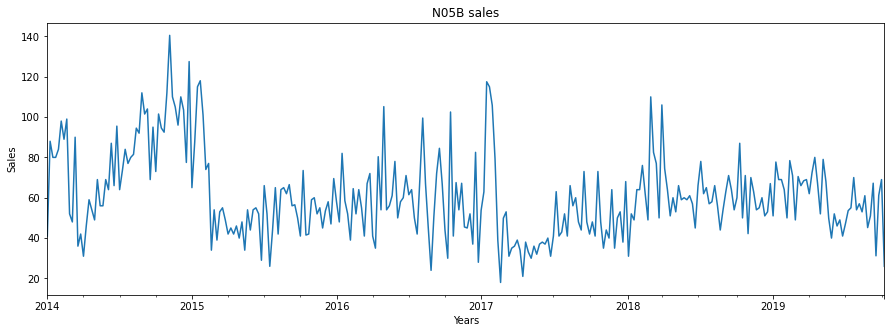

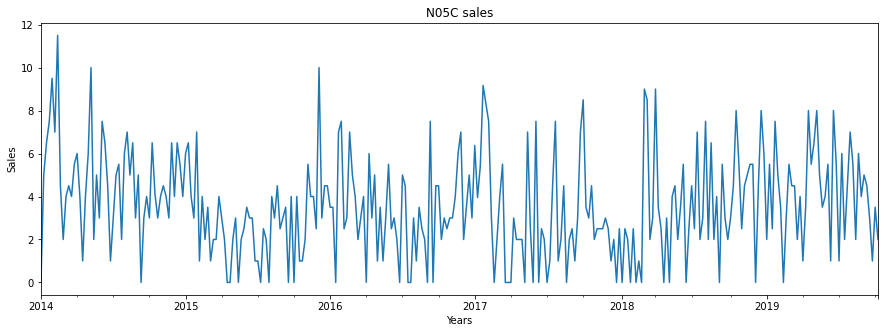

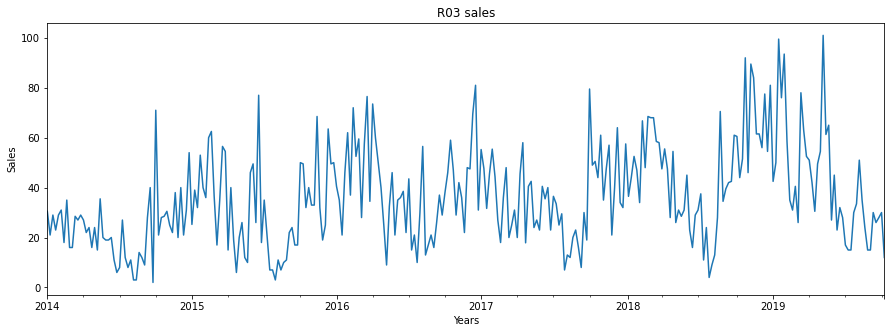

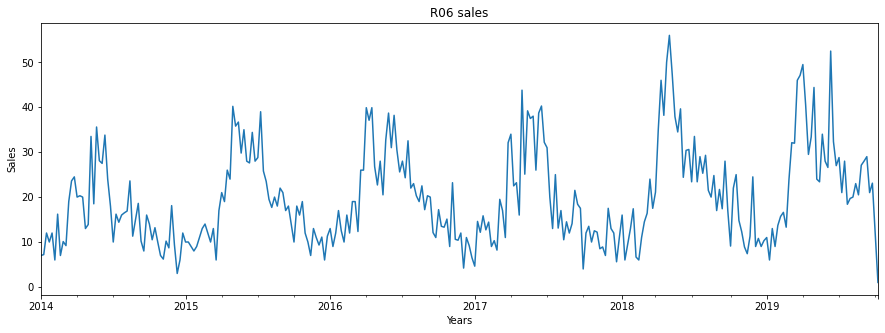

In [33]:
for drug in drug_list:
    plt.figure(figsize=(15,5))
    salesdaily[drug].resample('W').sum().plot();plt.title(drug+' '+'sales');plt.xlabel('Years');plt.ylabel('Sales');plt.show()


- From above line charts we can say that every drug has seasonality.
- we can use above line charts to determine stationarity of data. But this is subjective. 
- we use adfuller or other test to check stationarity of data with concrete evidence.
- This is weekly line chart, it will take summation of values of sale in week and plot the chart.

### Rolling mean 
To eliminate Seasonlaity we use Rolling mean.

Text(0.5, 1.0, 'All drugs')

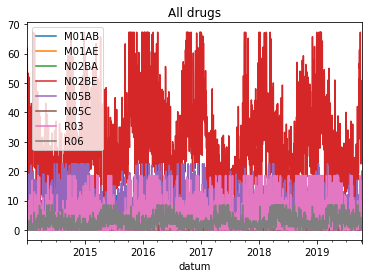

In [34]:
# Taking all drugs into one plot
salesdaily[drug_list].plot(label='org');plt.title('All drugs')

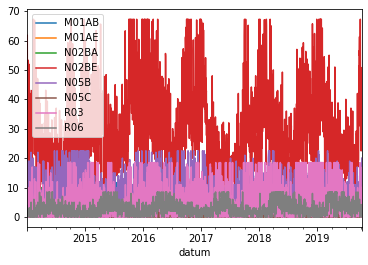

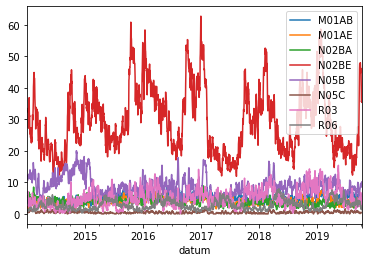

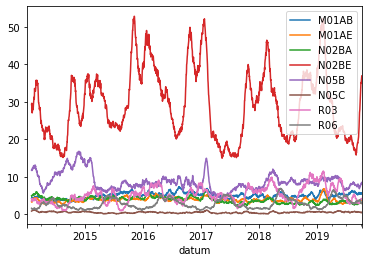

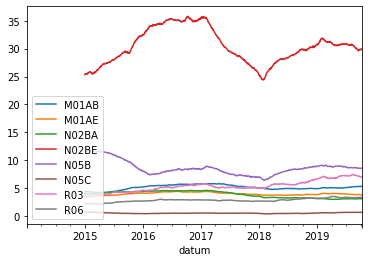

In [35]:
for i in [1,7,30,365]: # taking window width as 1,7,30,365 (these area days for dialy, weekly, monthly and yearly basis)
    salesdaily[drug_list].rolling(i).mean().plot(label=str(i))
plt.legend(loc=3)

window width = 365 gives less curve in lines, which eliminates seasonlity.

### Time Series Decomposition

- Four kinds of components help to make a time series, and also they can affect our time series analysis if present in excess. So here, for this time series, we need to check more for the availability of components.

- Time series decomposition is a technique that splits a time series into several components, each representing an underlying pattern category. These components are level, trend, seasonality, ( All three are systematic components) and noise (Non-systematic component of the time series).
- level: The average of data.
- Seasonality: describes the periodic signal in your time series.
- Trend: describes whether the time series is decreasing, constant, or increasing over time.
- Noise: describes what remains behind the separation of seasonality and trend from the time series. In other words, it’s the variability in the data that cannot be explained by the model.

https://www.statsmodels.org/dev/generated/statsmodels.tsa.seasonal.seasonal_decompose.html

https://towardsdatascience.com/time-series-decomposition-in-python-8acac385a5b2
- Read Documentation 

- A rule of thumb for selecting the right model (Additive or Multiplicative) is to see in line plot if the trend and seasonal variation are relatively constant over time, in other words, linear. If yes, then we will select the Additive model. Otherwise, if the trend and seasonal variation increase or decrease over time then we use the Multiplicative model.

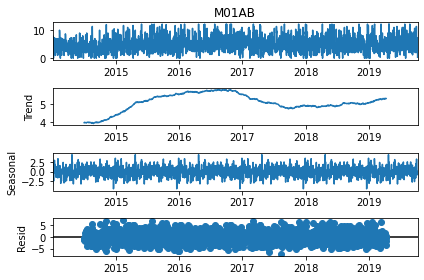

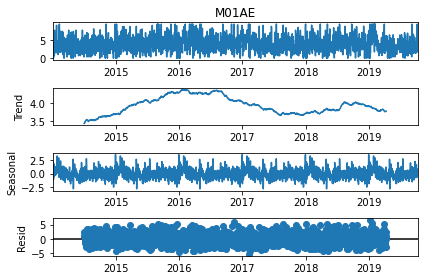

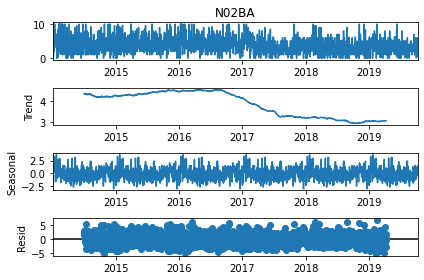

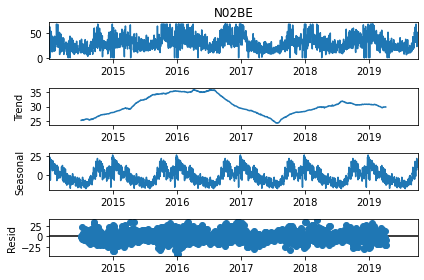

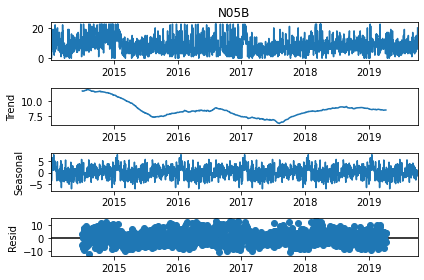

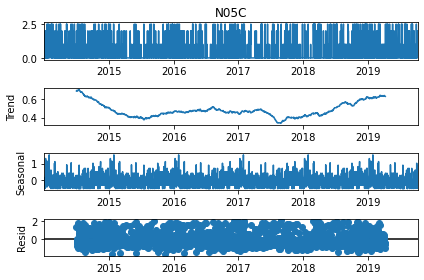

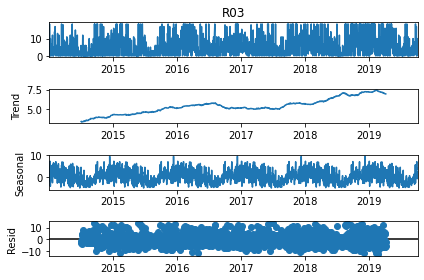

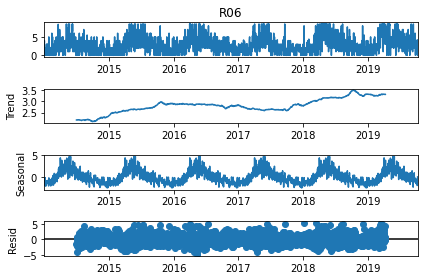

In [36]:
for drug in drug_list:
    decompose_ts_add = seasonal_decompose(salesdaily[drug], model = "additive", period = 365) #taking for 365 days
    decompose_ts_add.plot() # observe trend and seasonality.


# Stationarity of data


What is a Stationary Series:  A Stationary series is one whose statistical properties like mean, variance, covariance do not vary with time or these stats properties are not the function of time.

In other words, stationarity in Time Series also means series without a Trend or Seasonal components.

Why should time series be stationary: Stationary series is easier for statistical models to predict effectively and precisely.

Types of Stationary Series:
- Strict Stationary – Satisfies the mathematical definition of a stationary process and mean, variance & covariance are not the function of time.
- Seasonal Stationary – Series exhibiting seasonality.
- Trend stationary – Series exhibiting trend.

Note: Once the seasonality and trend is removed, series will be strict stationary

Two statistical tests which we will be discussing are:

- Augmented Dickey-Fuller (ADF) Test
- Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test

we can also check stationarity using line plot but it does not give any strong evidence. hence we use one of above test.

https://www.analyticsvidhya.com/blog/2021/06/statistical-tests-to-check-stationarity-in-time-series-part-1/#:~:text=Two%20tests%20for%20checking%20the,check%20stationarity%20in%20Time%20Series.

Read above article for statitionarity test.

we will use ADFuller test to check stationarity of data.

The Augmented Dickey-Fuller test is a type of statistical test called a unit root test.
In probability theory and statistics, a unit root is a feature of some stochastic processes (such as random walks) that can cause problems in statistical inference involving time series models. In a simple term, the unit root is non-stationary but does not always have a trend component.

ADF test is conducted with the following assumptions:

- Null Hypothesis (H0): Series is non-stationary or series has a unit root.

- Alternate Hypothesis(HA): Series is stationary or series has no unit root.

If the null hypothesis is failed to be rejected, this test may provide evidence that the series is non-stationary.

Conditions to Reject Null Hypothesis(H0)

If 
- Test statistic < Critical Value
AND
- p-value < 0.05 

Reject Null Hypothesis(H0) i.e., time series does not have a unit root, meaning it is stationary. It does not have a time-dependent structure.

In [37]:
from statsmodels.tsa.stattools import adfuller

In [38]:
# sample test for one drug
adtest = adfuller(salesdaily.M01AB, autolag='AIC')
print("1. ADF Test statistic value : ",adtest[0])
print("2. P-Value : ", adtest[1])
print("3. Num Of Lags : ", adtest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", adtest[3])
print("5. Critical Values :")
for key, val in adtest[4].items():
    print("\t",key, ": ", val)

1. ADF Test statistic value :  -8.164376113950741
2. P-Value :  8.965152528967642e-13
3. Num Of Lags :  14
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 2091
5. Critical Values :
	 1% :  -3.433481203206757
	 5% :  -2.862923230045995
	 10% :  -2.5675063669901363


In [39]:
if adtest[0] < adtest[4]['1%'] and adtest[0] <  adtest[4]['5%'] and adtest[0] < adtest[4]['10%']:
    print('success')
else:
    print("No")

success


In [40]:
for drug in drug_list:
    ad_test = adfuller(salesdaily[drug], autolag='AIC')
    print("1. ADF Test statistic value : ",ad_test[0])
    print("2. P-Value : ", ad_test[1])
    # print("3. Num Of Lags : ", ad_test[2])
    # print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", ad_test[3])
    print("5. Critical Values :")
    for key, val in ad_test[4].items():
        print("\t",key, ": ", val)
    
    
    if ad_test[1] <= 0.05 and adtest[0] < adtest[4]['1%'] and adtest[0] <  adtest[4]['5%'] and adtest[0] < adtest[4]['10%']:
        print(f'Reject Null hypothesis since time series data for {drug} is stationary .','\n','\n')
    else:
        print(f'Accept Null Hypothesis since time series data for {drug} is not stationary.','\n')

1. ADF Test statistic value :  -8.164376113950741
2. P-Value :  8.965152528967642e-13
5. Critical Values :
	 1% :  -3.433481203206757
	 5% :  -2.862923230045995
	 10% :  -2.5675063669901363
Reject Null hypothesis since time series data for M01AB is stationary . 
 

1. ADF Test statistic value :  -7.588171234791701
2. P-Value :  2.5733315345664343e-11
5. Critical Values :
	 1% :  -3.4334917336814543
	 5% :  -2.862927879505365
	 10% :  -2.567508842556946
Reject Null hypothesis since time series data for M01AE is stationary . 
 

1. ADF Test statistic value :  -5.787037434600972
2. P-Value :  4.971654587366189e-07
5. Critical Values :
	 1% :  -3.4334872119603324
	 5% :  -2.862925883058088
	 10% :  -2.567507779564507
Reject Null hypothesis since time series data for N02BA is stationary . 
 

1. ADF Test statistic value :  -3.9834531294716276
2. P-Value :  0.0014996774626385694
5. Critical Values :
	 1% :  -3.433479704613104
	 5% :  -2.8629225683793083
	 10% :  -2.5675060146913125
Reject Nu

Here we are getting all stationary data.

### ACF & PACF Plots
- It is not possible from graph to figure out exact value of correlation ACF is an (complete) auto-correlation function gives values of auto-correlation of any time series with its lagged values.

- ACF: Autocorrelation function and  PACF is a partial auto-correlation function. 

- ACF and PACF finds correlations of present with lags of the residuals of the time series
- ACF: ACF tells that on how many past observations, forecast is depend on.  ( it does not consider multi-collinearity)
- PACF: tell same but it consider effect of multi-collinearity.

 https://analyticsindiamag.com/guide-to-ac-and-pac-plots-in-time-series/ to uderstand ACF and PACF plot.

 For example: if ACF tells that Forecast is depend on last 150 (assuming) observation but it will not consider mutlicolinearilty among its
 lagged time series. PACF will eliminate the multicollinearity among its lagged time series. and take only those lagged series 
 which can change Forecast. PACF will give only 7 (assuming) lagged series instead of 150. 
 
  
 https://www.statsmodels.org/dev/generated/statsmodels.graphics.tsaplots.plot_acf.html
 https://www.statsmodels.org/dev/generated/statsmodels.graphics.tsaplots.plot_pacf.html
 
 ACF and PACF helps to get the values of p,d,q for ARIMA or related models.
 
 https://analyticsindiamag.com/quick-way-to-find-p-d-and-q-values-for-arima/  we can get all information about pdq values selection from this article.
 
- P value: get from PACF select number where vericle line crosses the confidence Intervel area (consider lines which are in shaded area).
- q value: get from ACF select number where vericle line crosses the confidence Intervel area (consider lines which are in shaded area).
- d value: depends on stationarity of data, if time series data is stationary then d=0 else it might be d=1 or d=2.

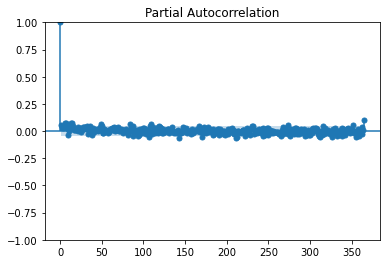

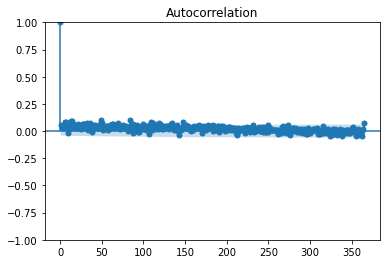

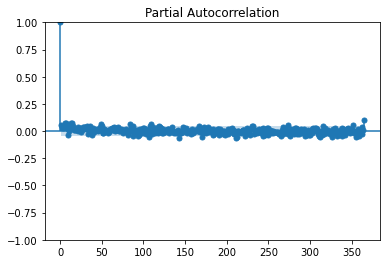

In [41]:
# ACF and PACF plot on Original data sets 
import statsmodels.graphics.tsaplots as tsa_plots


tsa_plots.plot_acf(salesdaily.M01AB, lags=365) # Auto-Correlation function plot

tsa_plots.plot_pacf(salesdaily.M01AB,lags=365) # Partial Auto-Correlation function plot

 - Keep lags as 10 to see first some lag values to reduce complexity and to see which lag value cross Confidence Interval (CI) area.

Plotting ACF and PACF for all drugs

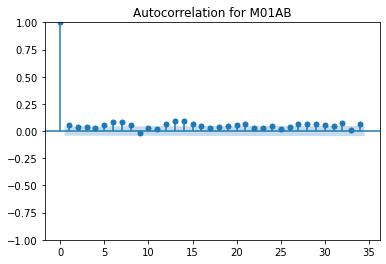

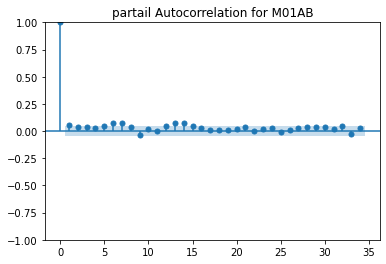

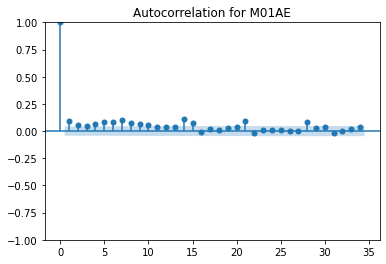

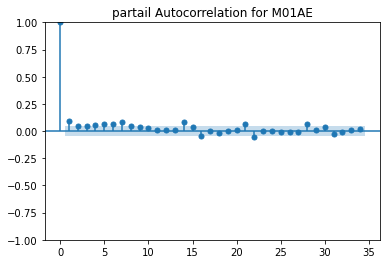

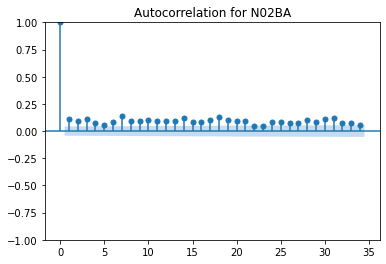

...

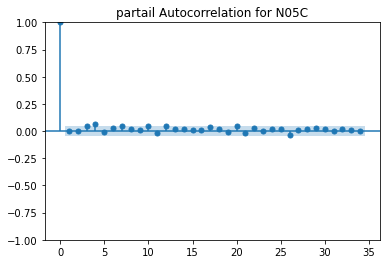

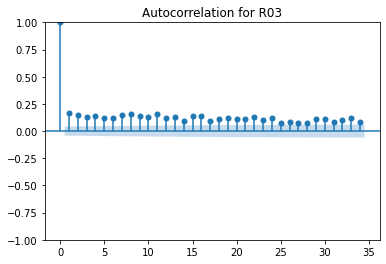

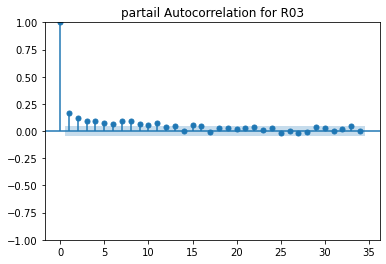

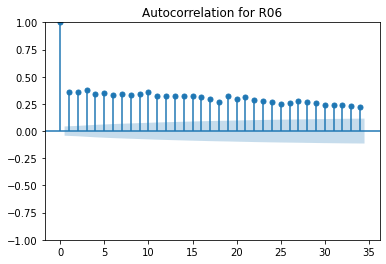

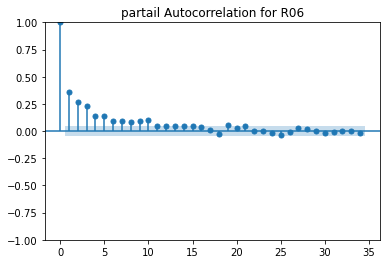

In [42]:
# Auto-Correlation PLots
for drug in drug_list:
    tsa_plots.plot_acf(salesdaily[drug], title = 'Autocorrelation for'+' '+drug) # taking default lags values in ACF anf PACF.
    tsa_plots.plot_pacf(salesdaily[drug], title = 'partail Autocorrelation for'+' '+drug)

- First lag is crossing CI area. Hence we can say that, Forecast depend on first lag only. 

# Data preperation 
- Remove Unwanted columns from dataset, we need date and drug column hence we will remove other columns.
- Split data into train test set.

In [43]:
# consider only date and drug columns
salesdaily = salesdaily[['M01AB','M01AE','N02BA','N02BE','N05B','N05C','R03','R06']]
salesdaily.head()

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
datum,,,,,,,,
2014-01-02,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0
2014-01-03,8.0,4.00,4.4,50.60,16.0,0.0,18.5,4.0
2014-01-04,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0
2014-01-05,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0
2014-01-06,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0


In [44]:
salesdaily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2106 entries, 2014-01-02 to 2019-10-08
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   M01AB   2106 non-null   float64
 1   M01AE   2106 non-null   float64
 2   N02BA   2106 non-null   float64
 3   N02BE   2106 non-null   float64
 4   N05B    2106 non-null   float64
 5   N05C    2106 non-null   float64
 6   R03     2106 non-null   float64
 7   R06     2106 non-null   float64
dtypes: float64(8)
memory usage: 148.1 KB


# Auto-ML
- Here we will use Auto-ML part to check which model is best for which drug sale. 
- we will use auto_timeseries fuction from auto-ts pacakge. This fuction will automatically calculate RMSE value for each model for each drug. So we can select best Forecast model for particular drug. 
- Auto-TS will use various models like, Facebook's Prophet, Auto-Arima or Sarima, Vector AutoRegression (VAR), and any  Machine learning model.  
- https://github.com/AutoViML/Auto_TS


In [45]:
from auto_ts import auto_timeseries

Imported auto_timeseries version:0.0.64. Call by using:
model = auto_timeseries(score_type='rmse',
        time_interval='M', non_seasonal_pdq=None, seasonality=False,
        seasonal_period=12, model_type=['best'], verbose=2, dask_xgboost_flag=0)
model.fit(traindata, ts_column,target)
model.predict(testdata, model='best')



#### Here we will take one drug to check does this Auto-ML work for our dataset or not.

In [46]:
sample_model = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,
                       model_type=['best'], verbose=2)

### Data split into Train and Test set

In [47]:
train_df = salesdaily.head(2106-70)
test_df = salesdaily.tail(70) # Taking large set of observations for test. 

Since auto_timeseries requires time series column, we will reset the index.

In [48]:
train_df.reset_index(inplace=True)
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2036 entries, 0 to 2035
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   datum   2036 non-null   datetime64[ns]
 1   M01AB   2036 non-null   float64       
 2   M01AE   2036 non-null   float64       
 3   N02BA   2036 non-null   float64       
 4   N02BE   2036 non-null   float64       
 5   N05B    2036 non-null   float64       
 6   N05C    2036 non-null   float64       
 7   R03     2036 non-null   float64       
 8   R06     2036 non-null   float64       
dtypes: datetime64[ns](1), float64(8)
memory usage: 143.3 KB


In [49]:
test_df.reset_index(inplace=True)
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70 entries, 0 to 69
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   datum   70 non-null     datetime64[ns]
 1   M01AB   70 non-null     float64       
 2   M01AE   70 non-null     float64       
 3   N02BA   70 non-null     float64       
 4   N02BE   70 non-null     float64       
 5   N05B    70 non-null     float64       
 6   N05C    70 non-null     float64       
 7   R03     70 non-null     float64       
 8   R06     70 non-null     float64       
dtypes: datetime64[ns](1), float64(8)
memory usage: 5.0 KB


#### We will use entire dataset to check model results and get the best model

In [50]:
df = salesdaily.reset_index()
df.head()

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
0,2014-01-02,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0
1,2014-01-03,8.0,4.00,4.4,50.60,16.0,0.0,18.5,4.0
2,2014-01-04,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0
3,2014-01-05,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0
4,2014-01-06,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0


### Run Sample model building for one drug to see possible errors and ways to correct them.

Since we have not seen multicollinearity among drug column, we will take specific data for model building.

Start of Fit.....
    Target variable given as = M01AB
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['M01AB']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model


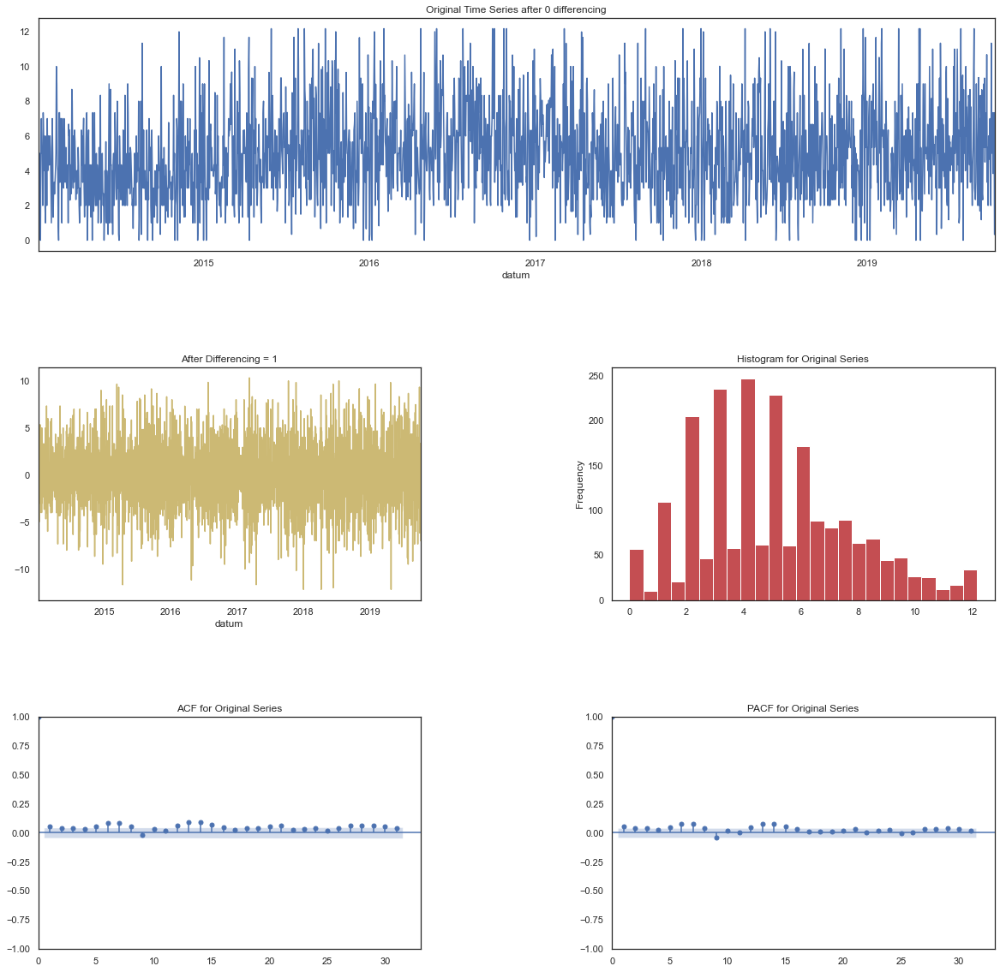

Time Interval is given as D
    Correct Time interval given as a valid Pandas date-range frequency...


Building Prophet Model



Running Facebook Prophet Model...
    Fit-Predict data (shape=(2106, 2)) with Confidence Interval = 0.95...
  Starting Prophet Fit
       Adding daily seasonality to Prophet with period=7, fourier_order=15 and prior_scale=0.10
  Starting Prophet Cross Validation
Max. iterations using expanding window cross validation = 3

Fold Number: 1 --> Train Shape: 2091 Test Shape: 5
    RMSE = 1.61
    Std Deviation of actuals = 1.69
    Normalized RMSE (as pct of std dev) = 95%
Cross Validation window: 1 completed

Fold Number: 2 --> Train Shape: 2096 Test Shape: 5
    RMSE = 3.21
    Std Deviation of actuals = 3.18
    Normalized RMSE (as pct of std dev) = 101%
Cross Validation window: 2 completed

Fold Number: 3 --> Train Shape: 2101 Test Shape: 5
    RMSE = 2.83
    Std Deviation of actuals = 2.61
    Normalized RMSE (as pct of std dev) = 108%
Cross Validation wind


Fitting model on entire train set. Please be patient...
    Time taken to train model (in seconds) = 1

Best Model is: Prophet
    Best Model (Mean CV) Score: 2.55


--------------------------------------------------
Total time taken: 216 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name      rmse
0       Prophet  2.551999
2            ML  2.818937
1  auto_SARIMAX  3.260903


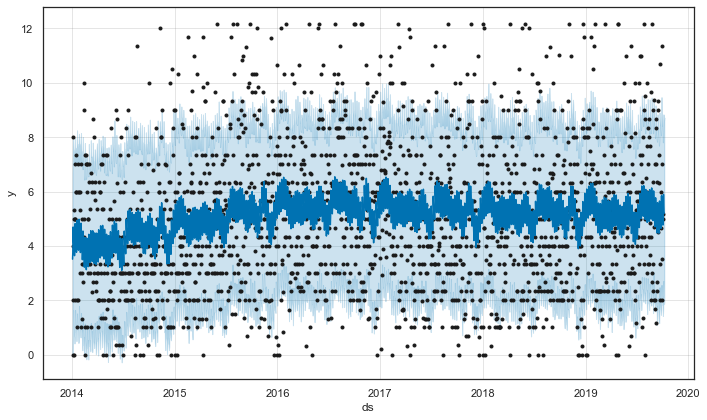

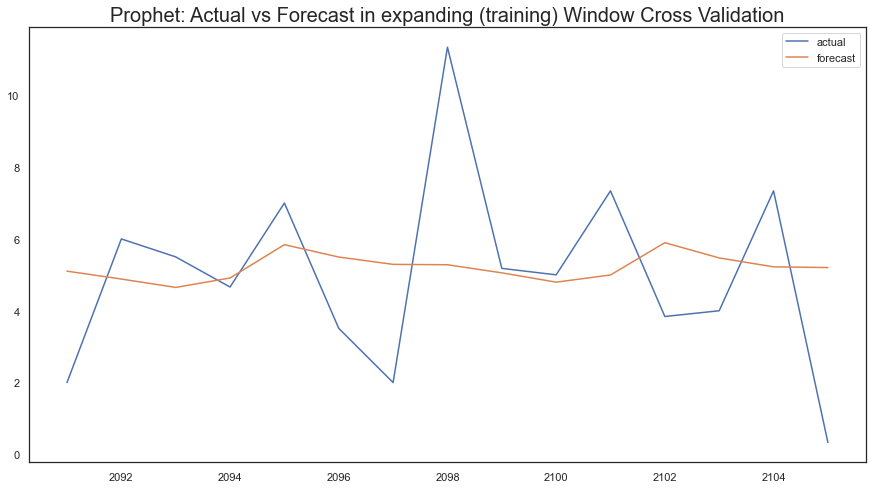

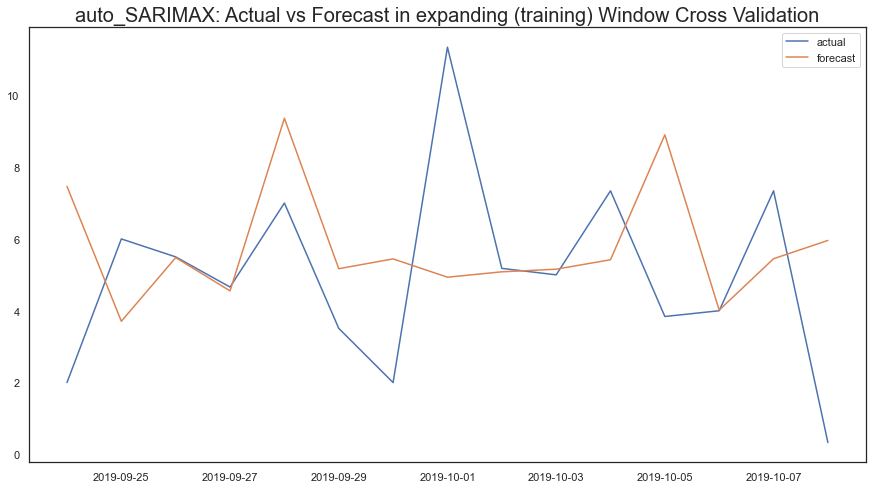

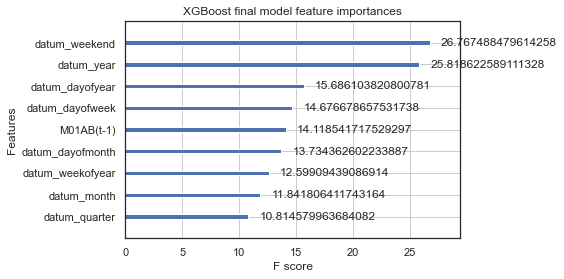

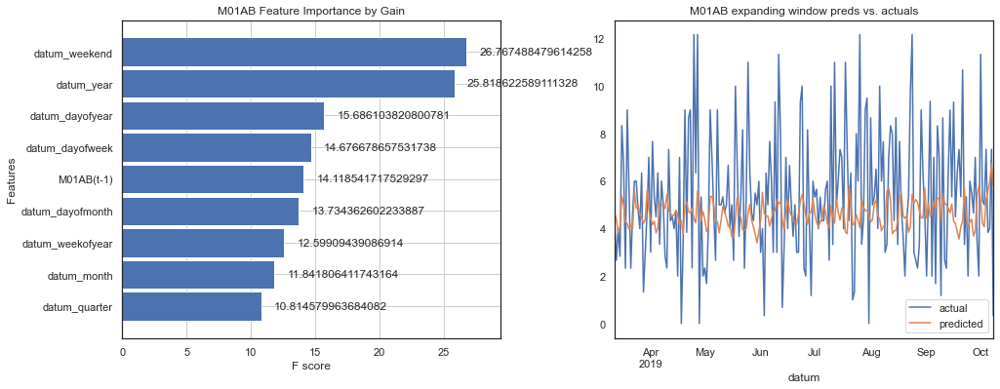

In [51]:
sample_model.fit(traindata=df[['datum','M01AB']], ts_column='datum', target='M01AB', cv=3)

From above time series model building we get Facebook Prophet as best model.

- Now we will create range of Dates that we will give in flask for prediction

In [52]:
pred_date = pd.date_range(start="2022-06-12",periods= 7)
pred_df = pd.DataFrame({ 'ds' : pred_date})
pred_df

,ds
0,2022-06-12
1,2022-06-13
2,2022-06-14
3,2022-06-15
4,2022-06-16
5,2022-06-17
6,2022-06-18


In [53]:
forecast_date_range = sample_model.predict(pred_df)
forecast_date_range # Getting wrong dates for prediction

Predicting using test dataframe as input for Prophet model
Building Forecast dataframe. Forecast Period = 7


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
2106,2019-10-09,5.096728,1.614519,8.115301,5.096728,5.096728,-0.204989,-0.204989,-0.204989,-0.220493,-0.220493,-0.220493,0.015505,0.015505,0.015505,0.0,0.0,0.0,4.891739
2107,2019-10-10,5.096625,1.237732,8.128812,5.096625,5.096625,-0.502706,-0.502706,-0.502706,-0.481546,-0.481546,-0.481546,-0.021160,-0.021160,-0.021160,0.0,0.0,0.0,4.593920
2108,2019-10-11,5.096523,1.509773,8.193963,5.096523,5.096523,-0.302968,-0.302968,-0.302968,-0.241934,-0.241934,-0.241934,-0.061034,-0.061034,-0.061034,0.0,0.0,0.0,4.793555
2109,2019-10-12,5.096420,2.242717,8.784066,5.096420,5.096420,0.548186,0.548186,0.548186,0.651399,0.651399,0.651399,-0.103213,-0.103213,-0.103213,0.0,0.0,0.0,5.644606
2110,2019-10-13,5.096318,1.840591,8.539764,5.096318,5.096318,0.098285,0.098285,0.098285,0.244988,0.244988,0.244988,-0.146703,-0.146703,-0.146703,0.0,0.0,0.0,5.194603
2111,2019-10-14,5.096215,1.526017,8.099872,5.096215,5.096215,-0.158674,-0.158674,-0.158674,0.031772,0.031772,0.031772,-0.190445,-0.190445,-0.190445,0.0,0.0,0.0,4.937541
2112,2019-10-15,5.096113,1.387918,8.132194,5.096113,5.096113,-0.217529,-0.217529,-0.217529,0.015814,0.015814,0.015814,-0.233343,-0.233343,-0.233343,0.0,0.0,0.0,4.878584


##### Manually build model then try

In [54]:
from fbprophet import Prophet

In [55]:
help(Prophet)


Help on class Prophet in module fbprophet.forecaster:

class Prophet(builtins.object)
 |  Prophet(growth='linear', changepoints=None, n_changepoints=25, changepoint_range=0.8, yearly_seasonality='auto', weekly_seasonality='auto', daily_seasonality='auto', holidays=None, seasonality_mode='additive', seasonality_prior_scale=10.0, holidays_prior_scale=10.0, changepoint_prior_scale=0.05, mcmc_samples=0, interval_width=0.8, uncertainty_samples=1000, stan_backend=None)
 |  
 |  Prophet forecaster.
 |  
 |  Parameters
 |  ----------
 |  growth: String 'linear' or 'logistic' to specify a linear or logistic
 |      trend.
 |  changepoints: List of dates at which to include potential changepoints. If
 |      not specified, potential changepoints are selected automatically.
 |  n_changepoints: Number of potential changepoints to include. Not used
 |      if input `changepoints` is supplied. If `changepoints` is not supplied,
 |      then n_changepoints potential changepoints are selected uniforml

In [56]:
# sample_model2 = Prophet()
sample_model2 = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)

In [57]:
df.head()

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
0,2014-01-02,0.0,3.67,3.4,32.40,7.0,0.0,0.0,2.0
1,2014-01-03,8.0,4.00,4.4,50.60,16.0,0.0,18.5,4.0
2,2014-01-04,2.0,1.00,6.5,61.85,10.0,0.0,9.0,1.0
3,2014-01-05,4.0,3.00,7.0,41.10,8.0,0.0,3.0,0.0
4,2014-01-06,5.0,1.00,4.5,21.70,16.0,2.0,6.0,2.0


In [58]:
# create timeseries readable by fbprophet
ts = pd.DataFrame({'ds':df.datum,'y':df.M01AB})
ts.head()

,ds,y
0,2014-01-02,0.0
1,2014-01-03,8.0
2,2014-01-04,2.0
3,2014-01-05,4.0
4,2014-01-06,5.0


In [59]:
sample_model2.fit(ts)

In [60]:
# use our created date range 
pred_M01AB = sample_model2.predict(pred_df) # taking same time train data to predict then  we will compare both RMSE values.
pred_M01AB # Here we are getting date that we want.

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-06-12,3.204611,2.784540,10.274799,1.483938,4.929903,3.485000,3.485000,3.485000,3.382743,...,0.245436,0.245436,0.245436,-0.143179,-0.143179,-0.143179,0.0,0.0,0.0,6.689611
1,2022-06-13,3.205768,2.657521,9.973301,1.485708,4.934355,3.224833,3.224833,3.224833,3.382743,...,0.031504,0.031504,0.031504,-0.189415,-0.189415,-0.189415,0.0,0.0,0.0,6.430601
2,2022-06-14,3.206924,2.611645,10.187690,1.487479,4.938807,3.161873,3.161873,3.161873,3.382743,...,0.015332,0.015332,0.015332,-0.236202,-0.236202,-0.236202,0.0,0.0,0.0,6.368798
3,2022-06-15,3.208081,2.233907,10.120118,1.489249,4.943259,2.879455,2.879455,2.879455,3.382743,...,-0.220505,-0.220505,-0.220505,-0.282783,-0.282783,-0.282783,0.0,0.0,0.0,6.087536
4,2022-06-16,3.209238,1.805519,9.321620,1.488364,4.947711,2.571933,2.571933,2.571933,3.382743,...,-0.482428,-0.482428,-0.482428,-0.328383,-0.328383,-0.328383,0.0,0.0,0.0,5.781170
5,2022-06-17,3.210394,1.949385,9.666198,1.484324,4.952163,2.768135,2.768135,2.768135,3.382743,...,-0.242378,-0.242378,-0.242378,-0.372231,-0.372231,-0.372231,0.0,0.0,0.0,5.978529
6,2022-06-18,3.211551,2.998026,10.336457,1.480302,4.956615,3.622214,3.622214,3.622214,3.382743,...,0.653039,0.653039,0.653039,-0.413568,-0.413568,-0.413568,0.0,0.0,0.0,6.833764


### Now we will check the RMSE value of Manully created model.

In [61]:
future_zero = sample_model2.make_future_dataframe(periods=0)
future_zero # if take period x number then it will add x more dates to axisting 2105 rows. total = 2105+x

,ds
0,2014-01-02
1,2014-01-03
2,2014-01-04
3,2014-01-05
4,2014-01-06
...,...
2101,2019-10-04
2102,2019-10-05
2103,2019-10-06
2104,2019-10-07


In [62]:
# use our created date range 
pred_M01AB2 = sample_model2.predict(future_zero) # taking same time train data to predict then  we will compare both RMSE values.
pred_M01AB2 # Here we are getting date that we want.

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2014-01-02,0.480630,0.096872,6.947477,0.480630,0.480630,3.170002,3.170002,3.170002,3.382743,...,-0.482428,-0.482428,-0.482428,0.269686,0.269686,0.269686,0.0,0.0,0.0,3.650632
1,2014-01-03,0.481169,0.602098,7.462743,0.481169,0.481169,3.428287,3.428287,3.428287,3.382743,...,-0.242378,-0.242378,-0.242378,0.287922,0.287922,0.287922,0.0,0.0,0.0,3.909457
2,2014-01-04,0.481708,1.721865,8.063070,0.481708,0.481708,4.340337,4.340337,4.340337,3.382743,...,0.653039,0.653039,0.653039,0.304554,0.304554,0.304554,0.0,0.0,0.0,4.822045
3,2014-01-05,0.482247,1.053488,7.950063,0.482247,0.482247,3.948156,3.948156,3.948156,3.382743,...,0.245436,0.245436,0.245436,0.319976,0.319976,0.319976,0.0,0.0,0.0,4.430403
4,2014-01-06,0.482786,0.779193,7.607872,0.482786,0.482786,3.748808,3.748808,3.748808,3.382743,...,0.031504,0.031504,0.031504,0.334560,0.334560,0.334560,0.0,0.0,0.0,4.231594
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,2019-10-04,2.068874,2.085087,8.437889,2.068874,2.068874,3.248170,3.248170,3.248170,3.382743,...,-0.242378,-0.242378,-0.242378,0.107805,0.107805,0.107805,0.0,0.0,0.0,5.317044
2102,2019-10-05,2.070030,2.980236,9.562115,2.070030,2.070030,4.135312,4.135312,4.135312,3.382743,...,0.653039,0.653039,0.653039,0.099530,0.099530,0.099530,0.0,0.0,0.0,6.205342
2103,2019-10-06,2.071187,2.631185,9.161139,2.071187,2.071187,3.713812,3.713812,3.713812,3.382743,...,0.245436,0.245436,0.245436,0.085632,0.085632,0.085632,0.0,0.0,0.0,5.784999
2104,2019-10-07,2.072343,2.237007,8.805620,2.072343,2.072343,3.480539,3.480539,3.480539,3.382743,...,0.031504,0.031504,0.031504,0.066291,0.066291,0.066291,0.0,0.0,0.0,5.552882


In [63]:
# Get RMSE values
def RMSE(prediction, original):
    diff = (prediction - original)
    return np.sqrt(np.mean(diff * diff))

#### Plot line chart 

In [64]:
pred_M01AB2=pred_M01AB2.set_index('ds')
ts2=ts.set_index('ds')

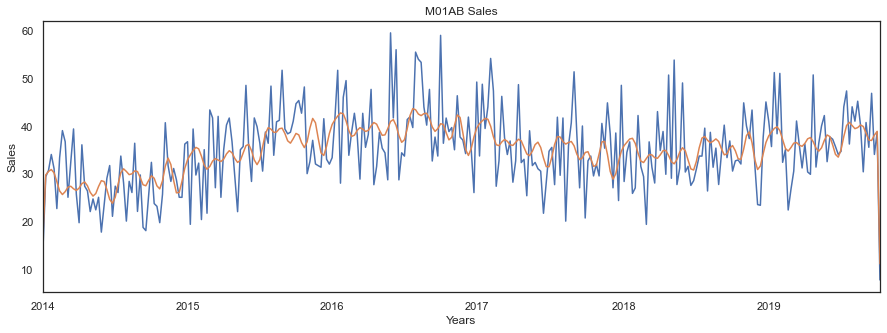

In [65]:
plt.figure(figsize=(15,5))
ts2.y.resample('W').sum().plot()
pred_M01AB2.yhat.resample('W').sum().plot();plt.title('M01AB'+' '+'Sales')
plt.xlabel('Years');plt.ylabel('Sales');plt.show()

In [66]:
print(RMSE(pred_M01AB2.yhat, ts2.y))

2.56538457569366


The RMSE value of Time series model is 2.55 and RMSE of manual model is 2.56. 

- Now pickle the sample model. lets does it happen or not.

In [67]:
import pickle

pickle.dump(sample_model, open('sample_model.pkl', 'wb'))

# model = pickle.load(open('sample_model.pkl','rb'))


# Need to check above command if it runs


AttributeError: Can't pickle local object 'auto_timeseries.fit.<locals>.<lambda>'

- From above sample model building, we have corrected all errors and our sample model has successfully Forecasted the sales for given dates. 
- And auto time series trained model cannot be converted to pickle file.
    

# Auto ML for all drugs. 
- we will build auto time series model for all drugs simultaneously.
- Here we will take Entire dataset to train the model. 
- Objective is to get the best model from this Auto time series. since we cannot make pickle file of this time series model.
- we will train manual models using train and test data. And make pickle files for deployment.

In [68]:
# Model Instances for all Drugs.
model_M01AB = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_M01AE = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_N02BA = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_N02BE = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_N05B  = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_N05C  = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_R03   = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])
model_R06   = auto_timeseries(score_type='rmse', time_interval='D', seasonality='True', seasonal_period=7,model_type=['best'])

In [69]:
df

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
0,2014-01-02,0.00,3.670,3.40,32.40,7.0,0.0,0.0,2.00
1,2014-01-03,8.00,4.000,4.40,50.60,16.0,0.0,18.5,4.00
2,2014-01-04,2.00,1.000,6.50,61.85,10.0,0.0,9.0,1.00
3,2014-01-05,4.00,3.000,7.00,41.10,8.0,0.0,3.0,0.00
4,2014-01-06,5.00,1.000,4.50,21.70,16.0,2.0,6.0,2.00
...,...,...,...,...,...,...,...,...,...
2101,2019-10-04,7.34,5.683,2.25,22.45,13.0,0.0,1.0,1.00
2102,2019-10-05,3.84,5.010,6.00,25.40,7.0,0.0,0.0,0.33
2103,2019-10-06,4.00,9.335,2.00,34.60,6.0,0.0,5.0,4.20
2104,2019-10-07,7.34,4.507,3.00,50.80,6.0,0.0,10.0,1.00


Taking df as training data, only to get best model.

Start of Fit.....
    Target variable given as = M01AB
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['M01AB']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. Continuing
Time Interval is given as D
    Correct Time interval given as a valid Pandas date-range frequency...


Building Prophet Model



Running Facebook Prophet Model...
  Starting Prophet Fit
       Adding daily seasonality to Prophet with period=7, fourier_order=15 and prior_scale=0.10
  Starting Prophet Cross Validation
Max. iterations using expanding window cross validation = 5

Fold N

    Time taken to train model (in seconds) = 1

Best Model is: Prophet
    Best Model (Mean CV) Score: 2.64


--------------------------------------------------
Total time taken: 177 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name      rmse
0       Prophet  2.638741
2            ML  2.818937
1  auto_SARIMAX  3.002056
Start of Fit.....
    Target variable given as = M01AE
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['M01AE']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. Con

    Time taken to train model (in seconds) = 1

Best Model is: Prophet
    Best Model (Mean CV) Score: 1.52


--------------------------------------------------
Total time taken: 417 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name      rmse
0       Prophet  1.522019
2            ML  1.781550
1  auto_SARIMAX  1.786693
Start of Fit.....
    Target variable given as = N02BA
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['N02BA']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. Con

    Time taken to train model (in seconds) = 1

Best Model is: Prophet
    Best Model (Mean CV) Score: 1.80


--------------------------------------------------
Total time taken: 228 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name      rmse
0       Prophet  1.796683
2            ML  1.823574
1  auto_SARIMAX  1.920383
Start of Fit.....
    Target variable given as = N02BE
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['N02BE']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. Con

    Time taken to train model (in seconds) = 1

Best Model is: ML
    Best Model (Mean CV) Score: 11.74


--------------------------------------------------
Total time taken: 616 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name       rmse
2            ML  11.738412
0       Prophet  12.781870
1  auto_SARIMAX  16.402190
Start of Fit.....
    Target variable given as = N05B
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['N05B']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. Conti

    Time taken to train model (in seconds) = 1

Best Model is: auto_SARIMAX
    Best Model (Mean CV) Score: 3.93


--------------------------------------------------
Total time taken: 263 seconds.
--------------------------------------------------


Leaderboard with best model on top of list:
            name      rmse
1  auto_SARIMAX  3.926523
2            ML  3.944651
0       Prophet  4.305455
Start of Fit.....
    Target variable given as = N05C
Start of loading of data.....
    Inputs: ts_column = datum, sep = ,, target = ['N05C']
    Using given input: pandas dataframe...
    datum column exists in given train data...
    train data shape = (2106, 1)
Alert: Could not detect strf_time_format of datum. Provide strf_time format during "setup" for better results.

Running Augmented Dickey-Fuller test with paramters:
    maxlag: 31 regression: c autolag: BIC
Data is already stationary
There is no differencing needed in this datasets for VAR model
No time series plot since verbose = 0. 

    RMSE = 4.29
    Std Deviation of actuals = 1.96
    Normalized RMSE (as pct of std dev) = 219%
Cross Validation window: 1 completed

Fold Number: 2 --> Train Shape: 2086 Test Shape: 5
    RMSE = 4.34
    Std Deviation of actuals = 2.79
    Normalized RMSE (as pct of std dev) = 156%
Cross Validation window: 2 completed

Fold Number: 3 --> Train Shape: 2091 Test Shape: 5
    RMSE = 7.63
    Std Deviation of actuals = 6.87
    Normalized RMSE (as pct of std dev) = 111%
Cross Validation window: 3 completed

Fold Number: 4 --> Train Shape: 2096 Test Shape: 5
    RMSE = 6.70
    Std Deviation of actuals = 6.02
    Normalized RMSE (as pct of std dev) = 111%
Cross Validation window: 4 completed

Fold Number: 5 --> Train Shape: 2101 Test Shape: 5
    RMSE = 6.19
    Std Deviation of actuals = 3.61
    Normalized RMSE (as pct of std dev) = 172%
Cross Validation window: 5 completed

-------------------------------------------
Model Cross Validation Results:
-----------------------------------

    RMSE = 2.74
    Std Deviation of actuals = 2.69
    Normalized RMSE (as pct of std dev) = 102%
Cross Validation window: 1 completed

Fold Number: 2 --> Train Shape: 2086 Test Shape: 5
    RMSE = 1.12
    Std Deviation of actuals = 0.40
    Normalized RMSE (as pct of std dev) = 280%
Cross Validation window: 2 completed

Fold Number: 3 --> Train Shape: 2091 Test Shape: 5
    RMSE = 2.01
    Std Deviation of actuals = 1.96
    Normalized RMSE (as pct of std dev) = 103%
Cross Validation window: 3 completed

Fold Number: 4 --> Train Shape: 2096 Test Shape: 5
    RMSE = 0.88
    Std Deviation of actuals = 0.38
    Normalized RMSE (as pct of std dev) = 230%
Cross Validation window: 4 completed

Fold Number: 5 --> Train Shape: 2101 Test Shape: 5
    RMSE = 2.09
    Std Deviation of actuals = 1.50
    Normalized RMSE (as pct of std dev) = 139%
Cross Validation window: 5 completed

-------------------------------------------
Model Cross Validation Results:
-----------------------------------

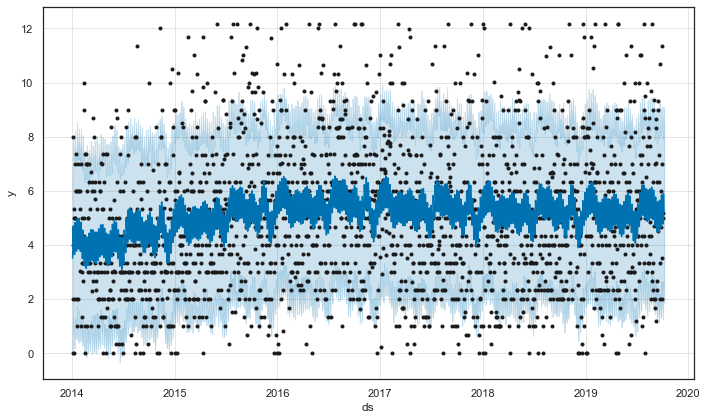

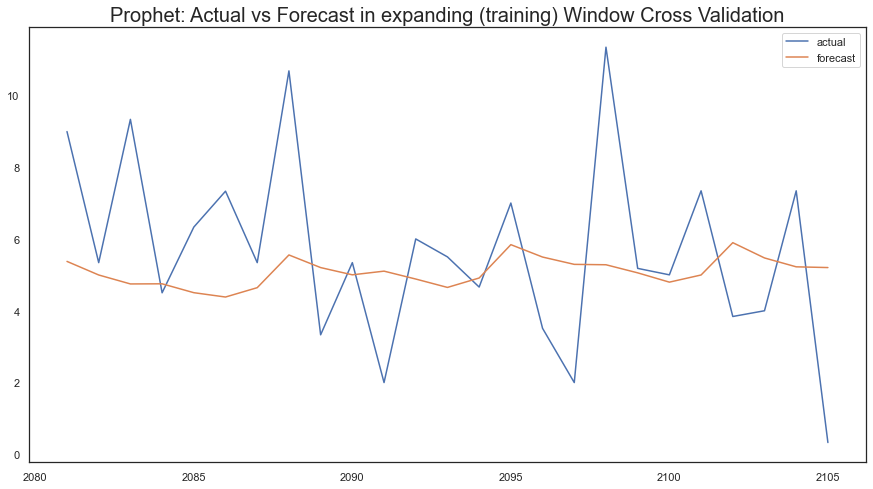

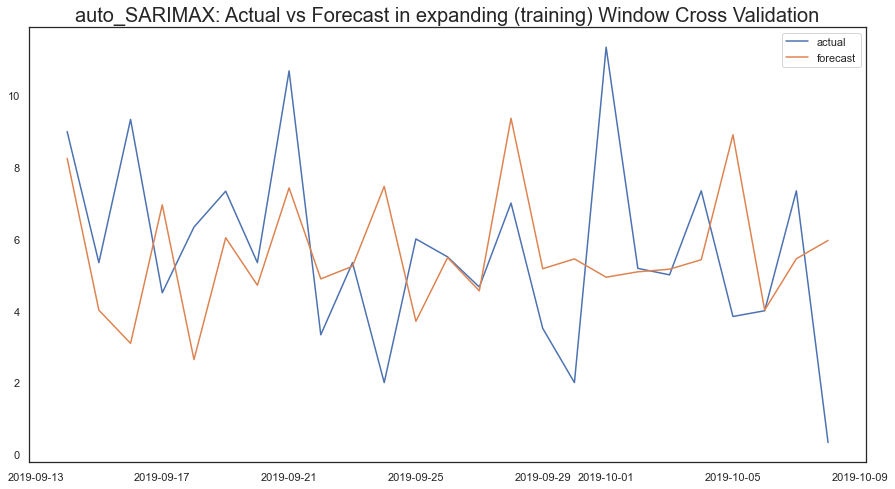

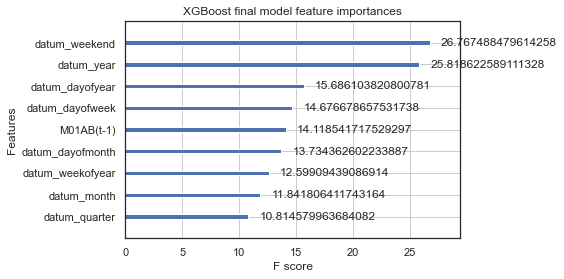

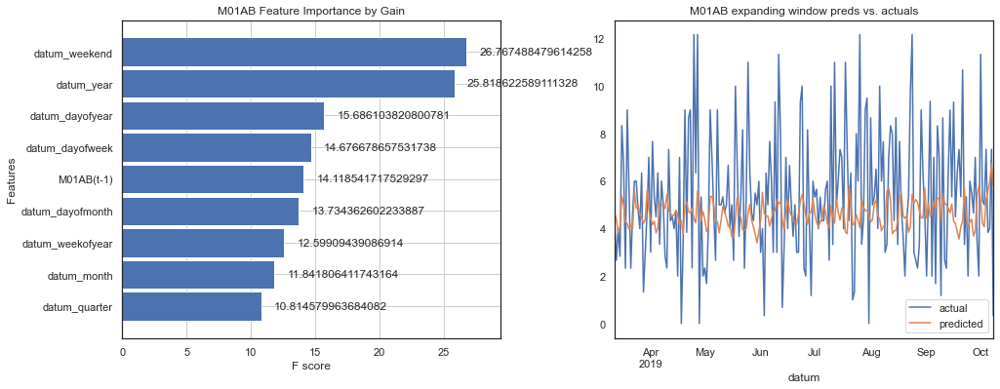

...

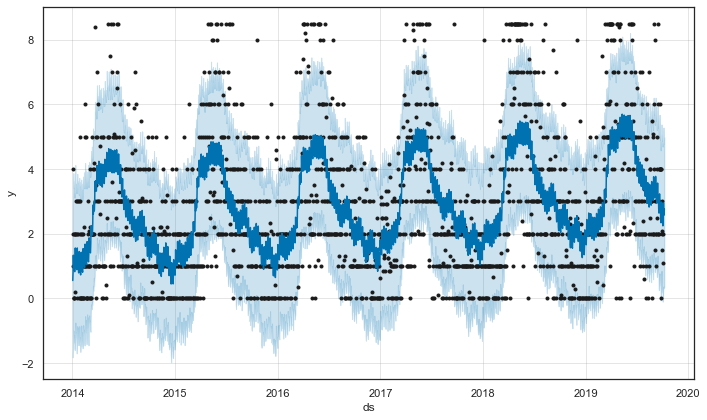

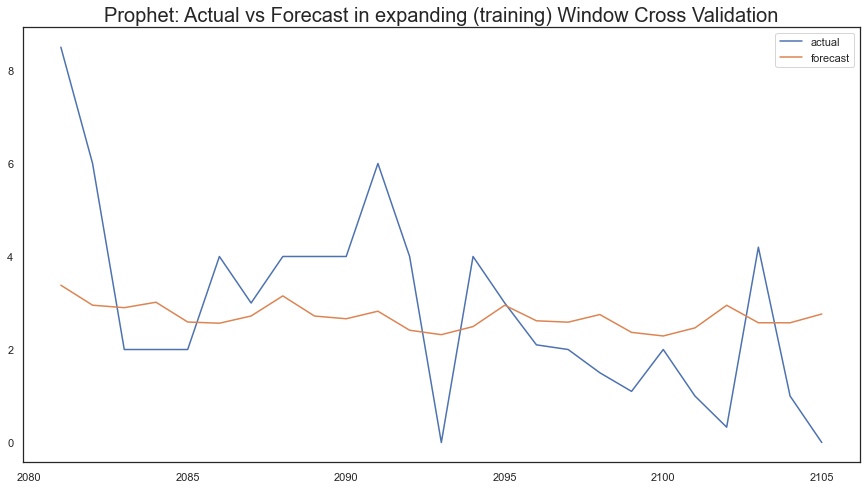

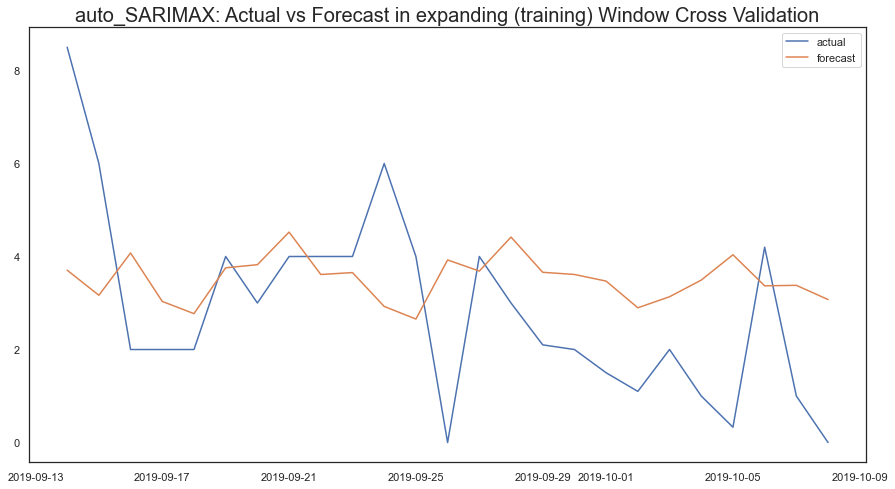

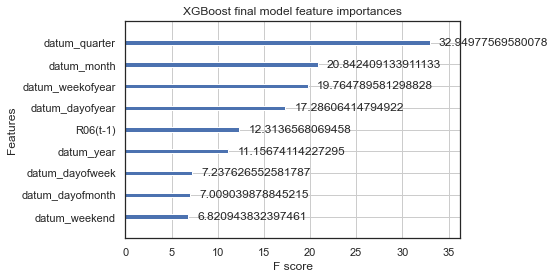

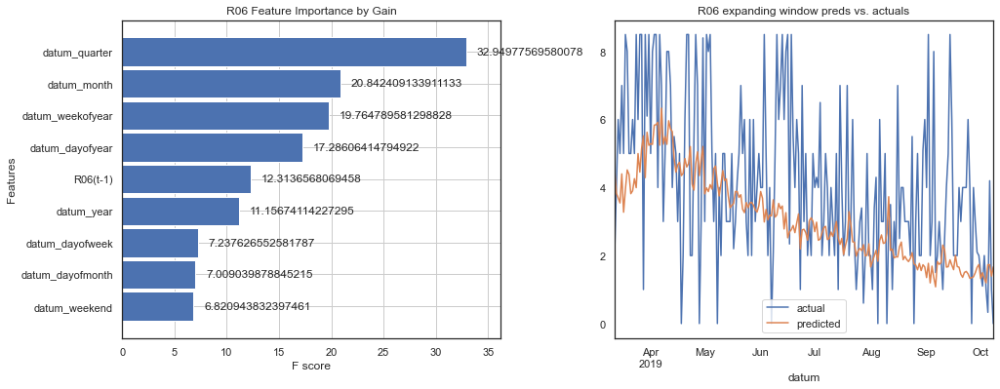

In [70]:
# List of tuples for model instances and drug Names.
model_drug = [(model_M01AB, 'M01AB'), (model_M01AE, 'M01AE'), (model_N02BA, 'N02BA'), (model_N02BE, 'N02BE'),
              (model_N05B, 'N05B'), (model_N05C, 'N05C'), (model_R03, 'R03'), (model_R06, 'R06') ]

for model, drug in model_drug:
    model.fit(traindata=df[['datum', drug]], ts_column='datum', target=drug, cv=5)
   
 

### Get the best model for all drugs.

In [71]:
# Getting Best model from auto-TS
for model, drug in model_drug:
    print(drug, '\n',model.get_leaderboard(), '\n') 

M01AB 
            name      rmse
0       Prophet  2.638741
2            ML  2.818937
1  auto_SARIMAX  3.002056 

M01AE 
            name      rmse
0       Prophet  1.522019
2            ML  1.781550
1  auto_SARIMAX  1.786693 

N02BA 
            name      rmse
0       Prophet  1.796683
2            ML  1.823574
1  auto_SARIMAX  1.920383 

N02BE 
            name       rmse
2            ML  11.738412
0       Prophet  12.781870
1  auto_SARIMAX  16.402190 

N05B 
            name      rmse
1  auto_SARIMAX  3.926523
2            ML  3.944651
0       Prophet  4.305455 

N05C 
            name      rmse
0       Prophet  0.749360
1  auto_SARIMAX  0.894204
2            ML       inf 

R03 
            name      rmse
1  auto_SARIMAX  5.025190
0       Prophet  5.830087
2            ML  6.181905 

R06 
            name      rmse
0       Prophet  1.769095
1  auto_SARIMAX  1.987723
2            ML  2.448777 



List of Best model for all drugs:
- Prophet     : M01AB, M01AE, N02BA, N05C, R06
- ML          :N02BE,  
- Auto_Sarimax: R03, N05B

# Manual Model building & Evaluation
- we will select that best model got from Auto ML and relative drug to train the model manually.
- we will select most of the Hyper parameters obtained from time series.
### Evaluation:
There are a few ways to test the forecasting models, the most commonly used methods called Backtesting as a way to evaluate the forecasting model with metrics like RMSE, MAE, MAPE.
- BackTesting: It is to keep the later part of the data as Test data so that we can evaluate the model against this Test data.

##### RMSE (Root Mean Square Error):
This RMSE is the same RMSE that is used for evaluating prediction models that predict numeric values such as Linear Regression, Random Forest, etc.
RMSE is Square root of mean of summation of squares of errors. Error is difference between Actual and Forecasted vales. TO avoid positive and Negative difference of error we square them, then we take mean & in last we their square root.

##### MAE (Mean Absolute Error):
MAE is very similar to RMSE. Instead of taking squares of error like we do in RMSE for obvious reason, we take absolute difference of Actual and Forecasted values. Later on we take their Mean. Hence it is Mean of Absolute Error ie. MAE.

##### RMSE vs MAE:
Both RMSE and MAE do same task. RMSE take square of difference, here we can big numbers compared to MAE.

When we have to compare two or more models then RMSE will be best choice otherwise we can use MAE to evaluate the model.

The problem with these two RMSE and MAE is, when we are dealing with big numbers then RMSE and MAE values will be big. when we dealing with small numbers then RMSE and MAE value will be small. 

For Example:
when you have two sales forecasting models created for two countries. One country has data ranging between 10 to 50 and another country is ranging between 1,000 and 5,000. Their RMSEs are quite different from one another. And this makes it harder for us to say which country’s model fits better for each country’s data.

This is when other metrics like MAPE come in handy

##### MAPE (Mean Absolute Percentage Error):
MAPE is an average of absolute percentage differences between the actual and the forecasted values. It emphasizes the percentage (or ratio) difference, not the actual difference, hence it normalizes and would be much less impacted by whether the actual data is big or small.

For Example: 
1. Actual value = 10, Forecast value = 12, abs. difference = |10-12|=2, % of diff to actula value = (2/10)*100 = 20%
2. Actual value = 15, Forecast value = 10, abs. difference = |15-10|=5, % of diff to actula value = (5/15)*100 = 33.33%

MAPE = (20+33.33)/2 = 26.65 %

we will get all these values.

Note: Lower the Error, higher the accuracy.

Article for Reference:
https://blog.exploratory.io/a-gentle-introduction-to-backtesting-for-evaluating-the-prophet-forecasting-models-66c132adc37c

In [72]:
# RMSE value
def RMSE(Forecast, Actual):
    diff = (Forecast - Actual)
    return round(np.sqrt(np.mean(diff * diff)), 2) # round off upto 2 decimal digit

In [73]:
# MAPE to get percent error
def MAPE(Forecast, Actual):
    percent_ratio = np.abs((Forecast-Actual) / Actual)*100
    return round(np.mean(percent_ratio), 2)

In [74]:
# Define data set for each model.
ts_M01AB = pd.DataFrame({'ds':train_df.datum,'y':train_df.M01AB})
ts_M01AE = pd.DataFrame({'ds':train_df.datum,'y':train_df.M01AE})
ts_N02BA = pd.DataFrame({'ds':train_df.datum,'y':train_df.N02BA})
ts_N02BE = pd.DataFrame({'ds':train_df.datum,'y':train_df.N02BE})
ts_N05C = pd.DataFrame({'ds':train_df.datum,'y':train_df.N05C})
ts_R06 = pd.DataFrame({'ds':train_df.datum,'y':train_df.R06})
ts_R03 = pd.DataFrame({'ds':train_df.datum,'y':train_df.R03})
ts_N05B = pd.DataFrame({'ds':train_df.datum,'y':train_df.N05B})

In [75]:
test_df

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
0,2019-07-31,0.00,2.840,2.00,21.00,4.0,0.0,4.0,2.00
1,2019-08-01,8.67,0.913,2.00,37.00,6.0,0.0,1.0,2.00
2,2019-08-02,5.00,1.680,3.00,18.00,7.0,2.0,6.0,1.00
3,2019-08-03,5.34,4.680,2.30,12.00,6.0,2.5,1.0,3.40
4,2019-08-04,6.50,2.670,5.00,24.00,10.0,0.0,2.0,4.30
...,...,...,...,...,...,...,...,...,...
65,2019-10-04,7.34,5.683,2.25,22.45,13.0,0.0,1.0,1.00
66,2019-10-05,3.84,5.010,6.00,25.40,7.0,0.0,0.0,0.33
67,2019-10-06,4.00,9.335,2.00,34.60,6.0,0.0,5.0,4.20
68,2019-10-07,7.34,4.507,3.00,50.80,6.0,0.0,10.0,1.00


In [76]:
test_dates = pd.DataFrame({'ds':test_df.datum})
test_dates

,ds
0,2019-07-31
1,2019-08-01
2,2019-08-02
3,2019-08-03
4,2019-08-04
...,...
65,2019-10-04
66,2019-10-05
67,2019-10-06
68,2019-10-07


### Model Training
##### 1. Model Building for M01AB drug.

In [77]:
prophet_M01AB = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_M01AB.fit(ts_M01AB)

In [78]:
pred_M01AB = prophet_M01AB.predict(test_dates)
pred_M01AB

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,1.986788,2.173883,8.912663,1.986788,1.986788,3.558342,3.558342,3.558342,3.401067,...,-0.176366,-0.176366,-0.176366,0.333641,0.333641,0.333641,0.0,0.0,0.0,5.545130
1,2019-08-01,1.987921,1.907996,8.420535,1.987921,1.987921,3.168245,3.168245,3.168245,3.401067,...,-0.538062,-0.538062,-0.538062,0.305241,0.305241,0.305241,0.0,0.0,0.0,5.156166
2,2019-08-02,1.989054,2.300039,8.929174,1.989054,1.989054,3.436392,3.436392,3.436392,3.401067,...,-0.242416,-0.242416,-0.242416,0.277741,0.277741,0.277741,0.0,0.0,0.0,5.425446
3,2019-08-03,1.990187,2.927457,9.346590,1.990187,1.990187,4.270390,4.270390,4.270390,3.401067,...,0.617336,0.617336,0.617336,0.251988,0.251988,0.251988,0.0,0.0,0.0,6.260577
4,2019-08-04,1.991320,3.033114,9.345269,1.991320,1.991320,3.913030,3.913030,3.913030,3.401067,...,0.283203,0.283203,0.283203,0.228760,0.228760,0.228760,0.0,0.0,0.0,5.904350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,2.060430,2.047820,8.568538,2.039468,2.081902,3.322486,3.322486,3.322486,3.401067,...,-0.242416,-0.242416,-0.242416,0.163835,0.163835,0.163835,0.0,0.0,0.0,5.382916
66,2019-10-05,2.061563,3.035817,9.431469,2.039714,2.083695,4.184173,4.184173,4.184173,3.401067,...,0.617336,0.617336,0.617336,0.165771,0.165771,0.165771,0.0,0.0,0.0,6.245736
67,2019-10-06,2.062696,2.570514,9.141989,2.040440,2.085454,3.844786,3.844786,3.844786,3.401067,...,0.283203,0.283203,0.283203,0.160517,0.160517,0.160517,0.0,0.0,0.0,5.907482
68,2019-10-07,2.063829,2.222433,8.970280,2.041093,2.086998,3.601784,3.601784,3.601784,3.401067,...,0.052609,0.052609,0.052609,0.148108,0.148108,0.148108,0.0,0.0,0.0,5.665613


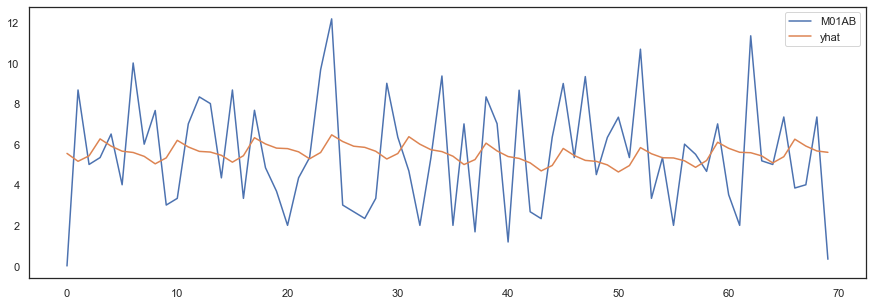

In [79]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.M01AB.plot()
pred_M01AB.yhat.plot()
plt.legend()
plt.show()

In [80]:
RMSE_M01AB = RMSE(pred_M01AB.yhat, test_df.M01AB)
RMSE_M01AB

2.75

In [81]:
MAPE_M01AB = MAPE(pred_M01AB.yhat, test_df.M01AB)
MAPE_M01AB

inf

# MAPE vs sMAPE

- Here we are not getting the value of Mean Absolute percentage error (MAPE), it is because in actual sales zero sometimes. Hence we are getting MAPE as inf for infinity.
- All our drug have shown zero sales in six years. Hence we cannot get MAPE values. 
- To solve this problem we will use "Symmetric Mean Absolute Percentage Error (sMAPE) or (SMAPE)" .
- The SMAPE is one of the alternatives to overcome the limitations with MAPE forecast error measurement.

https://stephenallwright.com/good-mape-score/ read for MAPE values interpretation and advantages.

MAPE value:

Advantages:
- Error given as a percentage
- Easy for end users to understand
- Possible to compare model accuracy across datasets and use cases

Limitaions:
- If your actual values can be 0, then MAPE isn't a good error metric, as you will have division by 0
- Sensitive to outliers
- there is no specific upper bound for MAPE values. MAPE value can exceed 100%.

sMAPE value:

Advantages:
- Expressed as a percentage.
- Fixes the shortcoming of the original MAPE — it has both the lower (0%) and the upper (200%) bounds.
Limitaions:
- Unstable when both the true value and the forecast are very close to zero.
- Whenever the actual value or the forecast has the value is 0, sMAPE will automatically hit the upper boundary value.

https://towardsdatascience.com/choosing-the-correct-error-metric-mape-vs-smape-5328dec53fac For Adantages of sMAPE values.

https://help.anaplan.com/685ff9b2-6370-46ba-af10-679405937113-Understand-advanced-metrics for other evaluation metrics like MAAPE, MASE, MAE, RMSE, SMAPE, MAPE, etc.

Note: Lower the error, better the accuracy. This applies to % error metrics also.

In [82]:
def sMAPE(Forecast, Actual):
    abs_diff = np.abs(Forecast-Actual)
    deno = ((np.abs(Actual)+np.abs(Forecast))/2) # take absolute values of actual and Forecast.
    sMAPE = (abs_diff/deno)*100
    return round(np.mean(sMAPE),2)

In [83]:
sMAPE_M01AB = sMAPE(pred_M01AB.yhat, test_df.M01AB)
sMAPE_M01AB

45.84

##### 2. Model Building for M01AE drug.

In [84]:
prophet_M01AE = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_M01AE.fit(ts_M01AE)

In [85]:
pred_M01AE = prophet_M01AE.predict(test_dates)
pred_M01AE

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,4.313873,0.849300,5.777459,4.313873,4.313873,-0.976460,-0.976460,-0.976460,-0.4587,...,-0.174010,-0.174010,-0.174010,-0.343750,-0.343750,-0.343750,0.0,0.0,0.0,3.337413
1,2019-08-01,4.313996,0.818876,5.665262,4.313996,4.313996,-1.065813,-1.065813,-1.065813,-0.4587,...,-0.253154,-0.253154,-0.253154,-0.353958,-0.353958,-0.353958,0.0,0.0,0.0,3.248183
2,2019-08-02,4.314119,0.702366,5.744248,4.314119,4.314119,-0.986133,-0.986133,-0.986133,-0.4587,...,-0.165352,-0.165352,-0.165352,-0.362081,-0.362081,-0.362081,0.0,0.0,0.0,3.327986
3,2019-08-03,4.314242,1.571863,6.267548,4.314242,4.314242,-0.386913,-0.386913,-0.386913,-0.4587,...,0.439708,0.439708,0.439708,-0.367920,-0.367920,-0.367920,0.0,0.0,0.0,3.927330
4,2019-08-04,4.314365,1.497895,6.709860,4.314365,4.314365,-0.213141,-0.213141,-0.213141,-0.4587,...,0.616855,0.616855,0.616855,-0.371296,-0.371296,-0.371296,0.0,0.0,0.0,4.101224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,4.321874,1.275239,6.440661,4.316003,4.328611,-0.464561,-0.464561,-0.464561,-0.4587,...,-0.165352,-0.165352,-0.165352,0.159492,0.159492,0.159492,0.0,0.0,0.0,3.857313
66,2019-10-05,4.321997,2.106578,6.876702,4.315925,4.328989,0.141677,0.141677,0.141677,-0.4587,...,0.439708,0.439708,0.439708,0.160670,0.160670,0.160670,0.0,0.0,0.0,4.463675
67,2019-10-06,4.322120,2.215973,7.172519,4.315852,4.329495,0.316983,0.316983,0.316983,-0.4587,...,0.616855,0.616855,0.616855,0.158828,0.158828,0.158828,0.0,0.0,0.0,4.639103
68,2019-10-07,4.322244,1.350575,6.392778,4.315791,4.329800,-0.456601,-0.456601,-0.456601,-0.4587,...,-0.151611,-0.151611,-0.151611,0.153710,0.153710,0.153710,0.0,0.0,0.0,3.865642


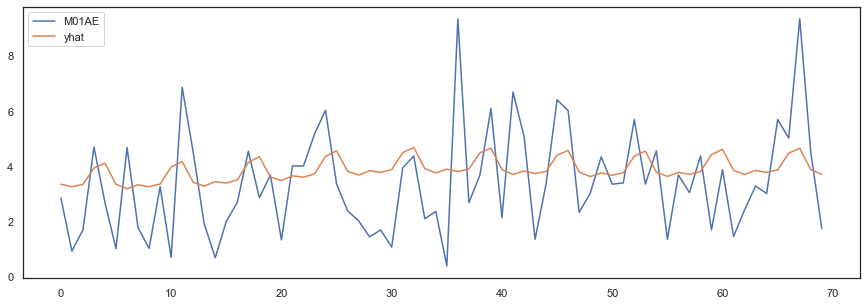

In [86]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.M01AE.plot()
pred_M01AE.yhat.plot()
plt.legend()
plt.show()

In [87]:
RMSE_M01AE = RMSE(pred_M01AE.yhat, test_df.M01AE)
RMSE_M01AE

1.82

In [88]:
MAPE_M01AE = MAPE(pred_M01AE.yhat, test_df.M01AE)
MAPE_M01AE

84.48

In [89]:
sMAPE_M01AE = sMAPE(pred_M01AE.yhat, test_df.M01AE)
sMAPE_M01AE

46.57

##### 3. Model Building for N02BA drug.

In [90]:
prophet_N02BA = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_N02BA.fit(ts_N02BA)

In [91]:
pred_N02BA = prophet_N02BA.predict(test_dates)
pred_N02BA

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,2.078800,-0.180220,5.661153,2.078800,2.078800,0.557091,0.557091,0.557091,0.979642,...,-0.100766,-0.100766,-0.100766,-0.321785,-0.321785,-0.321785,0.0,0.0,0.0,2.635891
1,2019-08-01,2.078681,-0.197708,5.294644,2.078681,2.078681,0.480319,0.480319,0.480319,0.979642,...,-0.206165,-0.206165,-0.206165,-0.293158,-0.293158,-0.293158,0.0,0.0,0.0,2.559000
2,2019-08-02,2.078562,-0.191850,5.645252,2.078562,2.078562,0.727769,0.727769,0.727769,0.979642,...,0.012584,0.012584,0.012584,-0.264457,-0.264457,-0.264457,0.0,0.0,0.0,2.806331
3,2019-08-03,2.078443,0.584608,5.927679,2.078443,2.078443,1.057434,1.057434,1.057434,0.979642,...,0.314035,0.314035,0.314035,-0.236243,-0.236243,-0.236243,0.0,0.0,0.0,3.135876
4,2019-08-04,2.078323,-0.080963,5.260376,2.078323,2.078323,0.388844,0.388844,0.388844,0.979642,...,-0.381733,-0.381733,-0.381733,-0.209065,-0.209065,-0.209065,0.0,0.0,0.0,2.467167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,2.071050,0.247868,5.676453,2.056190,2.081551,0.837284,0.837284,0.837284,0.979642,...,0.012584,0.012584,0.012584,-0.154943,-0.154943,-0.154943,0.0,0.0,0.0,2.908333
66,2019-10-05,2.070930,0.534670,6.139649,2.055650,2.081796,1.153056,1.153056,1.153056,0.979642,...,0.314035,0.314035,0.314035,-0.140621,-0.140621,-0.140621,0.0,0.0,0.0,3.223986
67,2019-10-06,2.070811,-0.125268,5.406312,2.054830,2.081893,0.471499,0.471499,0.471499,0.979642,...,-0.381733,-0.381733,-0.381733,-0.126410,-0.126410,-0.126410,0.0,0.0,0.0,2.542310
68,2019-10-07,2.070692,0.294556,5.676571,2.053868,2.082261,0.899011,0.899011,0.899011,0.979642,...,0.031488,0.031488,0.031488,-0.112119,-0.112119,-0.112119,0.0,0.0,0.0,2.969703


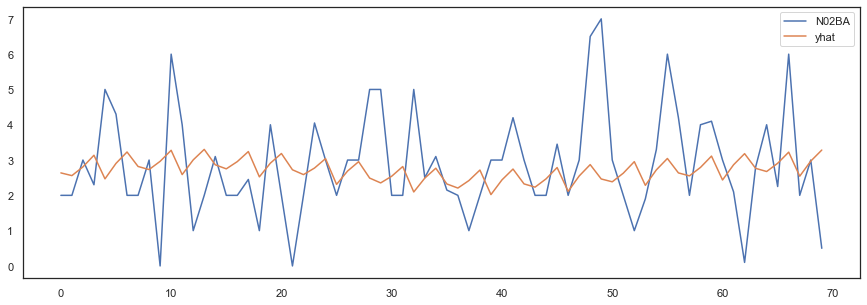

In [92]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.N02BA.plot()
pred_N02BA.yhat.plot()
plt.legend()
plt.show()

In [93]:
RMSE_N02BA = RMSE(pred_N02BA.yhat, test_df.N02BA)
RMSE_N02BA

1.53

In [94]:
MAPE_N02BA = MAPE(pred_N02BA.yhat, test_df.N02BA)
MAPE_N02BA

inf

In [95]:
sMAPE_N02BA = sMAPE(pred_N02BA.yhat, test_df.N02BA)
sMAPE_N02BA

43.1

##### 4. Model Building for N05C drug.

In [96]:
prophet_N05C = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_N05C.fit(ts_N05C)

In [97]:
pred_N05C = prophet_N05C.predict(test_dates)
pred_N05C

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,-0.007167,-0.316498,1.754502,-0.007167,-0.007167,0.736402,0.736402,0.736402,0.703152,...,0.054978,0.054978,0.054978,-0.021727,-0.021727,-0.021727,0.0,0.0,0.0,0.729235
1,2019-08-01,-0.006690,-0.335914,1.706174,-0.006690,-0.006690,0.641580,0.641580,0.641580,0.703152,...,-0.044419,-0.044419,-0.044419,-0.017152,-0.017152,-0.017152,0.0,0.0,0.0,0.634890
2,2019-08-02,-0.006213,-0.208237,1.763287,-0.006213,-0.006213,0.802411,0.802411,0.802411,0.703152,...,0.111841,0.111841,0.111841,-0.012582,-0.012582,-0.012582,0.0,0.0,0.0,0.796197
3,2019-08-03,-0.005736,-0.415383,1.652186,-0.005736,-0.005736,0.666690,0.666690,0.666690,0.703152,...,-0.028438,-0.028438,-0.028438,-0.008024,-0.008024,-0.008024,0.0,0.0,0.0,0.660954
4,2019-08-04,-0.005259,-0.567116,1.491225,-0.005259,-0.005259,0.492426,0.492426,0.492426,0.703152,...,-0.207236,-0.207236,-0.207236,-0.003490,-0.003490,-0.003490,0.0,0.0,0.0,0.487167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,0.023841,-0.147082,2.012913,0.021766,0.025769,0.907852,0.907852,0.907852,0.703152,...,0.111841,0.111841,0.111841,0.092859,0.092859,0.092859,0.0,0.0,0.0,0.931692
66,2019-10-05,0.024318,-0.226976,1.808453,0.022186,0.026320,0.760498,0.760498,0.760498,0.703152,...,-0.028438,-0.028438,-0.028438,0.085784,0.085784,0.085784,0.0,0.0,0.0,0.784816
67,2019-10-06,0.024795,-0.463979,1.668037,0.022620,0.026872,0.572927,0.572927,0.572927,0.703152,...,-0.207236,-0.207236,-0.207236,0.077011,0.077011,0.077011,0.0,0.0,0.0,0.597722
68,2019-10-07,0.025272,-0.232301,1.799906,0.023018,0.027439,0.805273,0.805273,0.805273,0.703152,...,0.035356,0.035356,0.035356,0.066766,0.066766,0.066766,0.0,0.0,0.0,0.830545


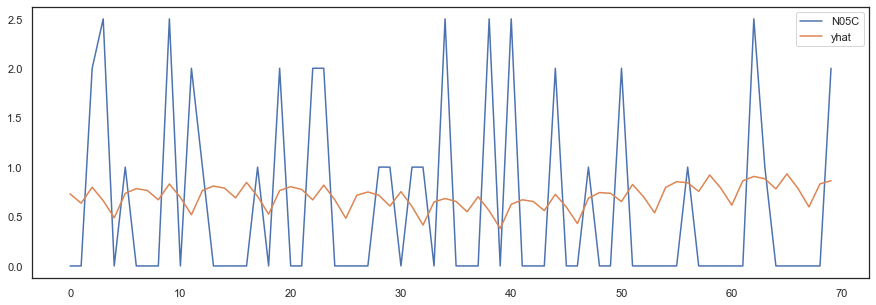

In [98]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.N05C.plot()
pred_N05C.yhat.plot()
plt.legend()
plt.show()

In [99]:
RMSE_N05C = RMSE(pred_N05C.yhat, test_df.N05C)
RMSE_N05C

0.9

In [100]:
MAPE_N05C = MAPE(pred_N05C.yhat, test_df.N05C)
MAPE_N05C

inf

In [101]:
sMAPE_N05C = sMAPE(pred_N05C.yhat, test_df.N05C)
sMAPE_N05C

157.11

##### 5. Model Building for R06 drug.

In [102]:
prophet_R06 = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_R06.fit(ts_R06)


In [103]:
pred_R06 = prophet_R06.predict(test_dates)
pred_R06

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,3.463079,0.996364,5.595246,3.463079,3.463079,-0.076786,-0.076786,-0.076786,-0.068419,...,-0.197874,-0.197874,-0.197874,0.189507,0.189507,0.189507,0.0,0.0,0.0,3.386293
1,2019-08-01,3.463715,0.975686,5.578184,3.463715,3.463715,-0.199745,-0.199745,-0.199745,-0.068419,...,-0.289993,-0.289993,-0.289993,0.158667,0.158667,0.158667,0.0,0.0,0.0,3.263970
2,2019-08-02,3.464351,1.124913,5.855094,3.464351,3.464351,-0.031934,-0.031934,-0.031934,-0.068419,...,-0.090101,-0.090101,-0.090101,0.126586,0.126586,0.126586,0.0,0.0,0.0,3.432417
3,2019-08-03,3.464987,1.494665,6.297866,3.464987,3.464987,0.421004,0.421004,0.421004,-0.068419,...,0.395800,0.395800,0.395800,0.093624,0.093624,0.093624,0.0,0.0,0.0,3.885992
4,2019-08-04,3.465624,1.135633,5.769664,3.465624,3.465624,0.001463,0.001463,0.001463,-0.068419,...,0.009706,0.009706,0.009706,0.060176,0.060176,0.060176,0.0,0.0,0.0,3.467086
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,3.504436,0.138307,4.792602,3.495613,3.511987,-1.016853,-1.016853,-1.016853,-0.068419,...,-0.090101,-0.090101,-0.090101,-0.858333,-0.858333,-0.858333,0.0,0.0,0.0,2.487582
66,2019-10-05,3.505072,0.637674,5.330731,3.495990,3.512578,-0.516472,-0.516472,-0.516472,-0.068419,...,0.395800,0.395800,0.395800,-0.843852,-0.843852,-0.843852,0.0,0.0,0.0,2.988600
67,2019-10-06,3.505708,0.127601,4.781584,3.496284,3.513258,-0.885058,-0.885058,-0.885058,-0.068419,...,0.009706,0.009706,0.009706,-0.826345,-0.826345,-0.826345,0.0,0.0,0.0,2.620650
68,2019-10-07,3.506344,0.289300,4.976714,3.496611,3.513978,-0.878569,-0.878569,-0.878569,-0.068419,...,-0.003728,-0.003728,-0.003728,-0.806421,-0.806421,-0.806421,0.0,0.0,0.0,2.627776


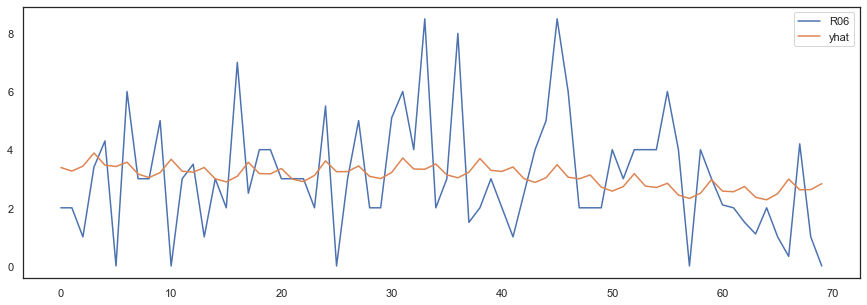

In [104]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.R06.plot()
pred_R06.yhat.plot()
plt.legend()
plt.show()

In [105]:
RMSE_R06 = RMSE(pred_R06.yhat, test_df.R06)
RMSE_R06

1.93

In [106]:
sMAPE_R06 = sMAPE(pred_R06.yhat, test_df.R06)
sMAPE_R06

54.15

In [107]:
MAPE_R06 = MAPE(pred_R06.yhat, test_df.R06)
MAPE_R06

inf

##### 6. Model Building for R03 drug.

### Sarimax model building

https://analyticsindiamag.com/complete-guide-to-sarimax-in-python-for-time-series-modeling/

Read Article for Sarimax model building.

   SARIMAX(Seasonal Auto-Regressive Integrated Moving Average with eXogenous factors) is an updated version of the ARIMA model. ARIMA includes an autoregressive integrated moving average, while SARIMAX includes seasonal effects and eXogenous factors with the autoregressive and moving average component in the model. Therefore, we can say SARIMAX is a seasonal equivalent model like SARIMA and Auto ARIMA.

To perform forecasting using the ARIMA model, we required a stationary time series. Stationary time series is a time series that is unaffected by these four components (Trend, level, seasonality, Noise). Most often, it happens when the data is non-stationary the predictions we get from the ARIMA model are worse or not that accurate.

If the data is not stationary, we can do one thing: either make the data stationary or use the SARIMAX model.


In [108]:
# Import Sarimax to Environment
import statsmodels.api as sm

we are getting pdq values from PACF and ACF plots for R03 Drug. we are getting p&q values as 1 and since data is stationary d=0
but 
we will use these values from time series and these values are order(p,d,q) = (1, 0, 1) and seasonal_order=(2, 1, [], 7)  

In [109]:
# We will make ds that is date column as index column
ts_R03_2 = ts_R03.set_index('ds')
ts_R03_2

,y
ds,
2014-01-02,0.0
2014-01-03,18.5
2014-01-04,9.0
2014-01-05,3.0
2014-01-06,6.0
...,...
2019-07-26,8.0
2019-07-27,2.0
2019-07-28,0.0


In [110]:
model=sm.tsa.statespace.SARIMAX(ts_R03_2.y,order=(1, 0, 1),seasonal_order=(2,1,0,7))
sarimax_R03 = model.fit()

In [111]:
test_df

,datum,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
0,2019-07-31,0.00,2.840,2.00,21.00,4.0,0.0,4.0,2.00
1,2019-08-01,8.67,0.913,2.00,37.00,6.0,0.0,1.0,2.00
2,2019-08-02,5.00,1.680,3.00,18.00,7.0,2.0,6.0,1.00
3,2019-08-03,5.34,4.680,2.30,12.00,6.0,2.5,1.0,3.40
4,2019-08-04,6.50,2.670,5.00,24.00,10.0,0.0,2.0,4.30
...,...,...,...,...,...,...,...,...,...
65,2019-10-04,7.34,5.683,2.25,22.45,13.0,0.0,1.0,1.00
66,2019-10-05,3.84,5.010,6.00,25.40,7.0,0.0,0.0,0.33
67,2019-10-06,4.00,9.335,2.00,34.60,6.0,0.0,5.0,4.20
68,2019-10-07,7.34,4.507,3.00,50.80,6.0,0.0,10.0,1.00


In [112]:
test_df_sarimax = test_df.set_index('datum')
test_df_sarimax

,M01AB,M01AE,N02BA,N02BE,N05B,N05C,R03,R06
datum,,,,,,,,
2019-07-31,0.00,2.840,2.00,21.00,4.0,0.0,4.0,2.00
2019-08-01,8.67,0.913,2.00,37.00,6.0,0.0,1.0,2.00
2019-08-02,5.00,1.680,3.00,18.00,7.0,2.0,6.0,1.00
2019-08-03,5.34,4.680,2.30,12.00,6.0,2.5,1.0,3.40
2019-08-04,6.50,2.670,5.00,24.00,10.0,0.0,2.0,4.30
...,...,...,...,...,...,...,...,...
2019-10-04,7.34,5.683,2.25,22.45,13.0,0.0,1.0,1.00
2019-10-05,3.84,5.010,6.00,25.40,7.0,0.0,0.0,0.33
2019-10-06,4.00,9.335,2.00,34.60,6.0,0.0,5.0,4.20


In [113]:
pred_R03= sarimax_R03.predict(start = 2019-7-31, end = 2019-10-8)
pred_R03

2019-06-06    10.510079
2019-06-07     3.446416
2019-06-08     9.647860
2019-06-09     8.319672
2019-06-10     5.972059
2019-06-11     6.010249
2019-06-12     3.364187
2019-06-13     9.097350
2019-06-14     7.926047
2019-06-15     7.158989
2019-06-16     5.085901
2019-06-17     3.208032
2019-06-18     7.363817
2019-06-19     0.225918
2019-06-20     5.674376
2019-06-21     4.762074
2019-06-22     5.149409
2019-06-23     2.189543
2019-06-24     4.538621
2019-06-25     7.022890
2019-06-26     1.207600
Freq: D, Name: predicted_mean, dtype: float64

In [114]:
pred_R03= sarimax_R03.predict(start = 2036, end = 2105)
pred_R03

2019-07-31     1.694194
2019-08-01     5.362895
2019-08-02     4.781415
2019-08-03     2.566784
2019-08-04     2.097292
                ...    
2019-10-04     5.482702
2019-10-05     2.992179
2019-10-06     1.251212
2019-10-07     0.538518
2019-10-08    11.962248
Freq: D, Name: predicted_mean, Length: 70, dtype: float64

##### Cannot use Sarimax for model building
Here while training Sarimax model we are getting several errors. we are not getting the output that we want from Sarimax model.
when we provide dates to get future Forecasts it is giving Forecast with Random date and number of Forecast is also less (expected 70 getting much less).

when we give number to get Forecast then getting good results but we cannot have number while deployment. This model will create problem while deployment or may not give expected results. 

Hence we will use prophet model for all. (since we tried to build ML model for N02BE but failed) 


##### Prophet model building for R03 drug.

In [115]:
prophet_R03 = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_R03.fit(ts_R03)

In [116]:
pred_R03 = prophet_R03.predict(test_dates)
pred_R03

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,4.979312,-2.426713,10.368681,4.979312,4.979312,-0.768570,-0.768570,-0.768570,2.502439,...,0.002926,0.002926,0.002926,-3.273935,-3.273935,-3.273935,0.0,0.0,0.0,4.210742
1,2019-08-01,4.982177,-3.158764,10.437818,4.982177,4.982177,-1.191535,-1.191535,-1.191535,2.502439,...,-0.431156,-0.431156,-0.431156,-3.262819,-3.262819,-3.262819,0.0,0.0,0.0,3.790642
2,2019-08-02,4.985043,-2.101375,10.986068,4.985043,4.985043,-0.474616,-0.474616,-0.474616,2.502439,...,0.267798,0.267798,0.267798,-3.244853,-3.244853,-3.244853,0.0,0.0,0.0,4.510426
3,2019-08-03,4.987908,-1.959288,10.524576,4.987908,4.987908,-0.748363,-0.748363,-0.748363,2.502439,...,-0.030867,-0.030867,-0.030867,-3.219935,-3.219935,-3.219935,0.0,0.0,0.0,4.239545
4,2019-08-04,4.990774,-2.166931,10.897758,4.990774,4.990774,-0.851857,-0.851857,-0.851857,2.502439,...,-0.166217,-0.166217,-0.166217,-3.188079,-3.188079,-3.188079,0.0,0.0,0.0,4.138917
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,5.165572,3.107617,16.478387,5.153558,5.180520,4.453687,4.453687,4.453687,2.502439,...,0.267798,0.267798,0.267798,1.683450,1.683450,1.683450,0.0,0.0,0.0,9.619259
66,2019-10-05,5.168437,3.040882,15.781653,5.156061,5.183783,4.184507,4.184507,4.184507,2.502439,...,-0.030867,-0.030867,-0.030867,1.712935,1.712935,1.712935,0.0,0.0,0.0,9.352944
67,2019-10-06,5.171303,2.518570,15.709730,5.158509,5.187013,4.062065,4.062065,4.062065,2.502439,...,-0.166217,-0.166217,-0.166217,1.725842,1.725842,1.725842,0.0,0.0,0.0,9.233368
68,2019-10-07,5.174169,3.105046,15.961387,5.161098,5.190426,4.575122,4.575122,4.575122,2.502439,...,0.349444,0.349444,0.349444,1.723239,1.723239,1.723239,0.0,0.0,0.0,9.749291


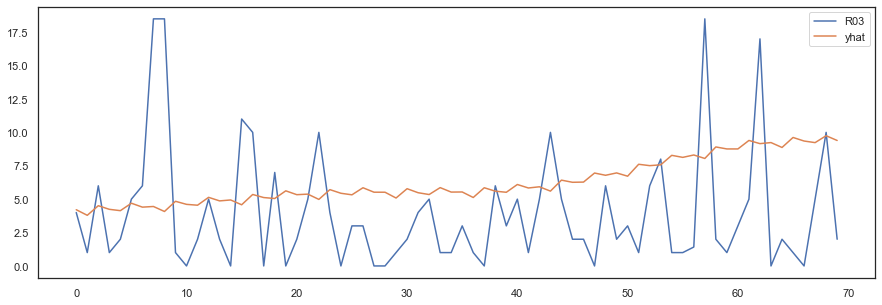

In [117]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.R03.plot()
pred_R03.yhat.plot()
plt.legend()
plt.show()

In [118]:
RMSE_R03 = RMSE(pred_R03.yhat, test_df.R03)
RMSE_R03


5.32

In [119]:
MAPE_R03 = MAPE(pred_R03.yhat, test_df.R03)
MAPE_R03

inf

In [120]:
sMAPE_R03 = sMAPE(pred_R03.yhat, test_df.R03)
sMAPE_R03

97.12

##### 7. Model Building for N02BE drug

In [121]:
prophet_N02BE = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_N02BE.fit(ts_N02BE)

In [122]:
pred_N02BE = prophet_N02BE.predict(test_dates)
pred_N02BE

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,36.706000,1.438441,31.533637,36.706000,36.706000,-20.082335,-20.082335,-20.082335,-6.448904,...,-1.602728,-1.602728,-1.602728,-12.030703,-12.030703,-12.030703,0.0,0.0,0.0,16.623665
1,2019-08-01,36.704709,2.707104,31.628706,36.704709,36.704709,-19.979479,-19.979479,-19.979479,-6.448904,...,-1.569201,-1.569201,-1.569201,-11.961374,-11.961374,-11.961374,0.0,0.0,0.0,16.725230
2,2019-08-02,36.703417,2.635736,31.640812,36.703417,36.703417,-19.653429,-19.653429,-19.653429,-6.448904,...,-1.345553,-1.345553,-1.345553,-11.858972,-11.858972,-11.858972,0.0,0.0,0.0,17.049988
3,2019-08-03,36.702126,7.276162,37.574758,36.702126,36.702126,-14.678301,-14.678301,-14.678301,-6.448904,...,3.495915,3.495915,3.495915,-11.725312,-11.725312,-11.725312,0.0,0.0,0.0,22.023825
4,2019-08-04,36.700834,6.549751,35.900759,36.700834,36.700834,-15.070030,-15.070030,-15.070030,-6.448904,...,2.941664,2.941664,2.941664,-11.562789,-11.562789,-11.562789,0.0,0.0,0.0,21.630805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,36.622054,26.007825,54.207268,36.323438,36.847296,3.494788,3.494788,3.494788,-6.448904,...,-1.345553,-1.345553,-1.345553,11.289244,11.289244,11.289244,0.0,0.0,0.0,40.116841
66,2019-10-05,36.620762,30.720049,59.645157,36.315214,36.851492,8.620394,8.620394,8.620394,-6.448904,...,3.495915,3.495915,3.495915,11.573383,11.573383,11.573383,0.0,0.0,0.0,45.241156
67,2019-10-06,36.619471,30.045654,59.295870,36.307249,36.855274,8.311318,8.311318,8.311318,-6.448904,...,2.941664,2.941664,2.941664,11.818558,11.818558,11.818558,0.0,0.0,0.0,44.930788
68,2019-10-07,36.618179,27.982743,56.268440,36.303510,36.865780,5.028331,5.028331,5.028331,-6.448904,...,-0.546923,-0.546923,-0.546923,12.024158,12.024158,12.024158,0.0,0.0,0.0,41.646510


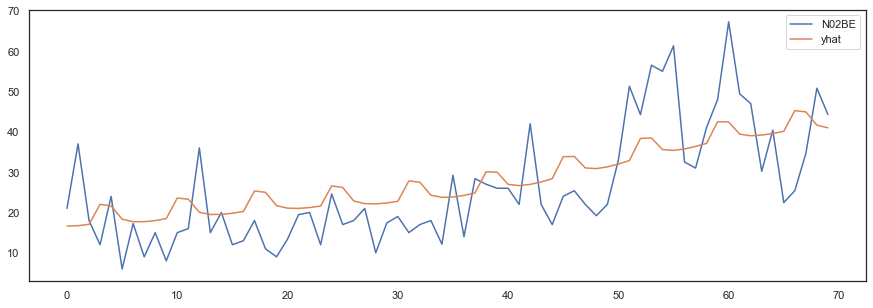

In [123]:
# taking line chart 
plt.figure(figsize=(15,5))
test_df.N02BE.plot()
pred_N02BE.yhat.plot()
plt.legend()
plt.show()

In [124]:
RMSE_N02BE = RMSE(pred_N02BE.yhat, test_df.N02BE)
RMSE_N02BE

10.26

In [125]:
MAPE_N02BE = MAPE(pred_N02BE.yhat, test_df.N02BE)
MAPE_N02BE


42.34

In [126]:
sMAPE_N02BE = sMAPE(pred_N02BE.yhat, test_df.N02BE)
sMAPE_N02BE

33.74

##### 8. Model Building for N05B drug

In [127]:
prophet_N05B = Prophet(growth='linear', daily_seasonality=7, seasonality_mode= 'additive',changepoint_prior_scale=0.30)
prophet_N05B.fit(ts_N05B)

In [128]:
pred_N05B = prophet_N05B.predict(test_dates)
pred_N05B

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-07-31,6.975275,4.237806,16.487646,6.975275,6.975275,3.721074,3.721074,3.721074,1.909995,...,1.341587,1.341587,1.341587,0.469491,0.469491,0.469491,0.0,0.0,0.0,10.696349
1,2019-08-01,6.975311,3.161741,15.632694,6.975311,6.975311,2.347445,2.347445,2.347445,1.909995,...,-0.114323,-0.114323,-0.114323,0.551772,0.551772,0.551772,0.0,0.0,0.0,9.322756
2,2019-08-02,6.975348,4.486670,16.479626,6.975348,6.975348,3.544260,3.544260,3.544260,1.909995,...,1.009841,1.009841,1.009841,0.624423,0.624423,0.624423,0.0,0.0,0.0,10.519608
3,2019-08-03,6.975385,3.573092,15.084602,6.975385,6.975385,2.294530,2.294530,2.294530,1.909995,...,-0.301723,-0.301723,-0.301723,0.686257,0.686257,0.686257,0.0,0.0,0.0,9.269914
4,2019-08-04,6.975421,0.524458,12.803132,6.975421,6.975421,-0.327474,-0.327474,-0.327474,1.909995,...,-2.973807,-2.973807,-2.973807,0.736337,0.736337,0.736337,0.0,0.0,0.0,6.647947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,2019-10-04,6.977657,3.613029,15.541007,6.826062,7.143198,2.424892,2.424892,2.424892,1.909995,...,1.009841,1.009841,1.009841,-0.494944,-0.494944,-0.494944,0.0,0.0,0.0,9.402549
66,2019-10-05,6.977693,1.759885,13.730466,6.818119,7.147215,1.096728,1.096728,1.096728,1.909995,...,-0.301723,-0.301723,-0.301723,-0.511544,-0.511544,-0.511544,0.0,0.0,0.0,8.074422
67,2019-10-06,6.977730,-0.004407,11.739717,6.811504,7.151358,-1.576774,-1.576774,-1.576774,1.909995,...,-2.973807,-2.973807,-2.973807,-0.512962,-0.512962,-0.512962,0.0,0.0,0.0,5.400957
68,2019-10-07,6.977767,3.181346,14.841951,6.802038,7.157964,1.768061,1.768061,1.768061,1.909995,...,0.357222,0.357222,0.357222,-0.499156,-0.499156,-0.499156,0.0,0.0,0.0,8.745828


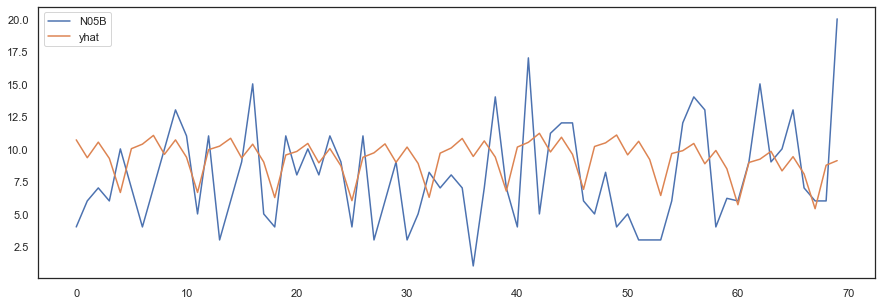

In [129]:

# taking line chart 
plt.figure(figsize=(15,5))
test_df.N05B.plot()
pred_N05B.yhat.plot()
plt.legend()
plt.show()

In [130]:

RMSE_N05B = RMSE(pred_N05B.yhat, test_df.N05B)
RMSE_N05B


4.09

In [131]:
MAPE_N05B = MAPE(pred_N05B.yhat, test_df.N05B)
MAPE_N05B

69.9

In [132]:
sMAPE_N05B = sMAPE(pred_N05B.yhat, test_df.N05B)
sMAPE_N05B

41.84

### All Evaluation values for all drugs


MAPE ------------> Interpretation  (Note: MAPE value may exceed 100%)
- Less than 10 % --------> Very good
- 10 % to 20 %----------->Good
- 20 % to 50 %----------->OK
- Greater than 50 %------>Not good

RMSE value has unit of measurement. It is simply difference between Forecast and Actual values. Lower the error better the accuracy of model.

MAPE value is also Error but it has no unit of Mearsurement, it is in percentage. lower the % better the accuracy.

sMPAE: its values is in range of 0% to 200%. we can interprete this one like MAPE value. 
we need lower sMAPE value.

In [133]:
Eval_df = pd.DataFrame({'drug_name': ['M01AB', 'M01AE', 'N02BA', 'N02BE', 'N05C', 'R06', 'N05B', 'R03' ], 
                 'RMSE_values': [RMSE_M01AB,RMSE_M01AE, RMSE_N02BA,RMSE_N02BE,RMSE_N05C, RMSE_R06, RMSE_N05B, RMSE_R03],
                 'MAPE_values': [MAPE_M01AB,MAPE_M01AE, MAPE_N02BA,MAPE_N02BE,MAPE_N05C, MAPE_R06, MAPE_N05B, MAPE_R03],
                'sMAPE_values': [sMAPE_M01AB, sMAPE_M01AE, sMAPE_N02BA, sMAPE_N02BE, sMAPE_N05C, sMAPE_R06, sMAPE_N05B, sMAPE_R03]})
Eval_df.head(10)

,drug_name,RMSE_values,MAPE_values,sMAPE_values
0,M01AB,2.75,inf,45.84
1,M01AE,1.82,84.48,46.57
2,N02BA,1.53,inf,43.10
3,N02BE,10.26,42.34,33.74
4,N05C,0.90,inf,157.11
5,R06,1.93,inf,54.15
6,N05B,4.09,69.90,41.84
7,R03,5.32,inf,97.12


In [134]:
os.getcwd()

'D:\\360digitmg\\DS Projects\\project codes'

# Create pickle files for all models.

In [135]:
import pickle

# Creating pickle file for all columns
pickle.dump(prophet_M01AB, open('model_M01AB.pkl', 'wb'))
pickle.dump(prophet_M01AE, open('model_M01AE.pkl', 'wb'))
pickle.dump(prophet_N02BA, open('model_N02BA.pkl', 'wb'))
pickle.dump(prophet_N02BE, open('model_N02BE.pkl', 'wb'))
pickle.dump(prophet_N05C, open('model_N05C.pkl', 'wb'))
pickle.dump(prophet_R06, open('model_MR06.pkl', 'wb'))
pickle.dump(prophet_R03, open('model_R03.pkl', 'wb'))
pickle.dump(prophet_N05B, open('model_N05B.pkl', 'wb'))

In [136]:
model_M01AB = pickle.load(open('model_M01AB.pkl','rb'))
model_M01AE = pickle.load(open('model_M01AE.pkl','rb'))
model_N02BA = pickle.load(open('model_N02BA.pkl','rb'))
model_N02BE = pickle.load(open('model_N02BE.pkl','rb'))
model_N05C = pickle.load(open('model_N05C.pkl','rb'))
model_MR06 = pickle.load(open('model_MR06.pkl','rb'))
model_R03 = pickle.load(open('model_R03.pkl','rb'))
model_N05B = pickle.load(open('model_N05B.pkl','rb'))

All pickle files are ready, Now we can proceed to model deployment.

# Conclusion



The Forecasting models will predict the future sales of each drug. The best Forecast models are selected on the basis of "RMSE" values in auto-ts library. The auto-ts library giving Facebook's Prophet model as a best model for 5 drug, Sarimax as a best model for 2 drugs and ML as best model for one drug.

Since Sarimax model is not giving the expected outputs and also it create problems while deployment, same thing happens with ML model. Hence we have trained all drugs time series data on Facebook's Prophet model only. FB Prophet is giving good accuracy and easy to deploy compared to other two model.


All our prophet models are performing well as per their sMAPE values.


# The END of the Project